<a href="https://colab.research.google.com/github/mohammadabid-macad/AIAStudioG03/blob/main/Notebooks/Streetview_Image_Segmentation_and_Facade_Material_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Old Material Classification (Without Segmentation Step)

In [ ]:
!pip install osmnx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.2/107.2 kB 2.8 MB/s eta 0:00:00


In [ ]:
!pip install requests pandas

In [ ]:
import os
import numpy as np
from PIL import Image
import tensorflow as tf
import requests
from io import BytesIO
import pandas as pd

In [ ]:
# Load the trained model
model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac AIA24/STUDIO/material_texture_classifier.keras')

# Print the model summary
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 63, 63, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 30, 30, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 28, 28, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 14, 14, 128)       0

In [ ]:
# Load the trained model
model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac AIA24/STUDIO/material_texture_classifier_0624.keras')

# Load the URLs from the CSV file
url_data = pd.read_csv('/content/drive/Shareddrives/Iaac AIA24/STUDIO/buildings_with_images.csv')  # Replace with the path to your CSV file containing URLs
image_urls = url_data['image_url']  # Use 'image_url' as the column name

# Define classes
classes = ['brick', 'ceramic', 'foliage', 'glass', 'metal', 'painted', 'sky', 'stone', 'tile', 'water', 'wood']

# Function to preprocess an image
def preprocess_image(image_url):
    try:
        response = requests.get(image_url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content))
        img = img.resize((128, 128))  # Resize to match model input size
        img_array = np.array(img) / 255.0  # Normalize pixel values
        return img_array
    except requests.RequestException as e:
        print(f"Error downloading image from {image_url}: {e}")
        return None
    except Exception as e:
        print(f"Error processing image from {image_url}: {e}")
        return None

# Initialize a DataFrame to store results
results = url_data.copy()

# Initialize columns for class probabilities
for class_name in classes:
    results[class_name] = np.nan

# Iterate over each URL and make predictions
for index, row in results.iterrows():
    image_url = row['image_url']
    street_view_image = preprocess_image(image_url)
    if street_view_image is not None:
        predictions = model.predict(np.expand_dims(street_view_image, axis=0))

        # Get predicted class probabilities
        predicted_probabilities = predictions[0]

        # Update the DataFrame with the predicted probabilities
        for i, class_name in enumerate(classes):
            results.at[index, class_name] = predicted_probabilities[i]
    else:
        print(f"Skipping image from {image_url} due to an error.")

# Save the results to a new CSV file
results.to_csv('/content/drive/Shareddrives/Iaac AIA24/STUDIO/Building Images with Material Predication 02.csv', index=False)



1/1 [==============================] - 0s 20ms/step


# META SAM Model (Failed to Segement Buildings)

In [ ]:
!pip install torch torchvision torchaudio

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

In [ ]:
!pip install git+https://github.com/facebookresearch/segment-anything.git

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-pbeoma4h
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-pbeoma4h
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36590 sha256=0002b5bee7f523b4bee4bc6ed96042733cd055c005d0a5ab8abf4b9435ec2463
  Stored in directory: /tmp/pip-ephem-wheel-cache-cxm5kq6p/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything


In [ ]:
import pandas as pd
import requests
from io import BytesIO
from PIL import Image
import numpy as np
import tensorflow as tf
from segment_anything import SamPredictor, sam_model_registry

In [ ]:
# Define classes
classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']

# Load the URLs from the CSV file
url_data = pd.read_csv('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/buildings_with_images.csv')
image_urls = url_data['image_url']

# Initialize a DataFrame to store results
results = url_data.copy()

# Initialize columns for class percentages
for class_name in classes:
    results[class_name] = np.nan

### Loading Models (Sam and Trained Material Classifier)

In [ ]:
# Step 2: Download the Checkpoint
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -O /content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/sam_vit_h_4b8939.pth

# Step 3: Verify the Download
!ls /content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/


--2024-06-22 09:51:51--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 108.157.254.15, 108.157.254.124, 108.157.254.102, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|108.157.254.15|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2564550879 (2.4G) [binary/octet-stream]
Saving to: ‘/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/sam_vit_h_4b8939.pth’

/content/drive/Shar 100%[===================>]   2.39G  81.8MB/s    in 30s     

2024-06-22 09:52:20 (82.0 MB/s) - ‘/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/sam_vit_h_4b8939.pth’ saved [2564550879/2564550879]

'Building Coordinates with Images (Mohamed CSV) with META SAM Model'   sam_vit_h_4b8939.pth


In [ ]:
# Replace this with the correct path to your SAM checkpoint
sam_checkpoint = "/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/sam_vit_h_4b8939.pth"

In [ ]:
# Load the SAM model
sam_checkpoint = "/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/sam_vit_h_4b8939.pth"
model_type = "vit_h"
device = "cuda" if tf.config.list_physical_devices('GPU') else "cpu"
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)
predictor = SamPredictor(sam)

# Load the trained classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.keras')


### Filtering out Model to work only on desired classes

In [ ]:
desired_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']


In [ ]:
# Assuming your model's classes are in this order
model_classes = ['brick', 'ceramic', 'foliage', 'glass', 'metal', 'painted', 'sky', 'stone', 'tile', 'water', 'wood']

# Create a mapping from model class indices to desired class indices
class_index_mapping = {i: desired_classes.index(cls) for i, cls in enumerate(model_classes) if cls in desired_classes}

# Print mapping for verification
print(class_index_mapping)


{0: 0, 1: 1, 3: 2, 4: 3, 7: 5, 8: 6, 10: 7}


### Streetview Images Processing

In [ ]:
def preprocess_image(image_url):
    try:
        response = requests.get(image_url, timeout=10)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except requests.RequestException as e:
        print(f"Error downloading image from {image_url}: {e}")
        return None
    except Exception as e:
        print(f"Error processing image from {image_url}: {e}")
        return None

### Isolating "Buildings" using the SAM Model

In [ ]:
def classify_segment(segment):
    segment_resized = tf.image.resize(segment, (128, 128))  # Ensure the size matches your classifier input
    segment_expanded = np.expand_dims(segment_resized, axis=0)
    predictions = classifier_model.predict(segment_expanded)

    # Filter and map predictions to the desired classes
    filtered_predictions = np.zeros(len(desired_classes))
    for model_index, desired_index in class_index_mapping.items():
        filtered_predictions[desired_index] = predictions[0][model_index]

    # Debugging: Print the filtered predictions
    print(f"Filtered predictions: {filtered_predictions}")

    predicted_class = desired_classes[np.argmax(filtered_predictions)]
    return predicted_class


In [ ]:
def is_building_segment(segment_mask, image_height, image_width):
    segment_area = np.sum(segment_mask)
    if segment_area > 0.02 * segment_mask.size:  # Lowered threshold for detecting smaller segments
        segment_position = np.where(segment_mask > 0)
        vertical_extent = np.max(segment_position[0]) - np.min(segment_position[0])

        # Check if the segment covers a substantial part of the vertical dimension and is in the lower part of the image
        if vertical_extent > image_height * 0.3 and np.mean(segment_position[0]) > image_height * 0.4:
            return True
    return False


### Process Each Image, Segment It, and Classify Building Segments (Not Successful - Before Finetuining and using the Hugging Face)

In [ ]:
# Process each image, segment it, and classify building segments
for index, row in results.iterrows():
    image_url = row['image_url']
    original_image = preprocess_image(image_url)
    if original_image is not None:
        original_image_np = np.array(original_image) / 255.0
        predictor.set_image(original_image_np)
        masks, _, _ = predictor.predict()

        building_mask_total = np.zeros_like(masks[0])

        # Aggregate building masks
        for mask in masks:
            if is_building_segment(mask, original_image_np.shape[0], original_image_np.shape[1]):
                building_mask_total = np.maximum(building_mask_total, mask)

        building_area = np.sum(building_mask_total)
        total_area = original_image_np.shape[0] * original_image_np.shape[1]
        building_area_percentage = (building_area / total_area) * 100

        if building_area > 0:
            material_areas = {class_name: 0 for class_name in desired_classes}

            for mask in masks:
                if is_building_segment(mask, original_image_np.shape[0], original_image_np.shape[1]):
                    mask_np = mask.astype(np.float32)
                    segment = original_image_np * mask_np[..., np.newaxis]
                    class_name = classify_segment(segment)
                    material_areas[class_name] += np.sum(mask)

            for class_name in desired_classes:
                results.at[index, class_name] = (material_areas[class_name] / building_area) * 100
        else:
            print(f"No building detected in image from {image_url}.")
    else:
        print(f"Skipping image from {image_url} due to an error.")


1/1 [==============================] - 0s 22ms/step
Filtered predictions: [2.80693099e-02 1.71777944e-03 2.43260413e-02 1.58362923e-08
 0.00000000e+00 7.22092092e-02 1.55746727e-03 6.82530925e-04]
1/1 [==============================] - 0s 21ms/step
Filtered predictions: [4.20506410e-02 6.99874526e-03 6.23123348e-02 3.17647864e-05
 0.00000000e+00 5.80752790e-02 2.47492418e-02 6.13716617e-03]
1/1 [==============================] - 0s 20ms/step
Filtered predictions: [0.10961217 0.0355487  0.09635827 0.00015476 0.         0.11828824
 0.06136941 0.03368545]
1/1 [==============================] - 0s 20ms/step
Filtered predictions: [1.11838348e-01 1.45818824e-02 3.74972783e-02 3.19218561e-05
 0.00000000e+00 2.29596198e-01 2.21548434e-02 1.21458573e-02]
1/1 [==============================] - 0s 20ms/step
Filtered predictions: [2.19301376e-02 4.48702136e-03 4.41803411e-02 4.77787125e-07
 0.00000000e+00 4.30662148e-02 7.10300962e-03 1.95084151e-03]
1/1 [==============================] - 0s 20ms/

In [ ]:
import os

# Define the directory path
directory_path = '/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP'

# Create the directory if it does not exist
if not os.path.exists(directory_path):
    os.makedirs(directory_path)

# Save the results to a CSV file
results.to_csv(os.path.join(directory_path, 'Building Images with Material Prediction 02.csv'), index=False)



# HugginFace Transform Segementation

In [ ]:
!pip install transformers


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/285 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/dpt/feature_extraction_dpt.py:28: FutureWarning: The class DPTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use DPTImageProcessor instead.
  warnings.warn(


config.json:   0%|          | 0.00/6.91k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.37G [00:00<?, ?B/s]

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

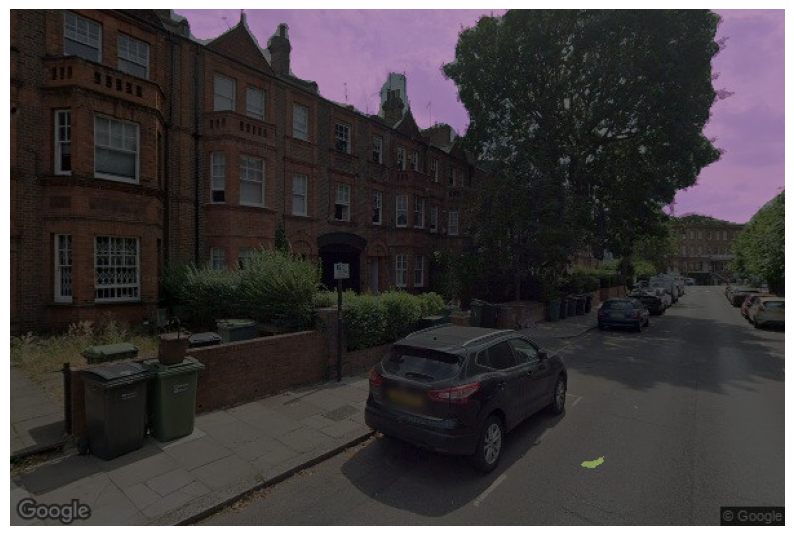

Unique classes in the segmentation map: [  0   1   2   4   6   7   8   9  10  11  14  17  20  22  32  38  41  43
  62  63 112 125 138]


In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the colors for each class (using ADE20K color mapping)
colors = {
    0: [0, 0, 0],        # Background
    2: [128, 64, 128],   # Building
    13: [128, 128, 192], # Car
    8: [107, 142, 35],   # Tree
    12: [255, 255, 255]  # Sidewalk
}

# Visualize the segmentation
colored_segmentation = np.zeros((predicted_labels.shape[0], predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, color in colors.items():
    colored_segmentation[predicted_labels == class_id] = color

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Debugging: Print unique classes in the segmentation map
unique_classes = np.unique(predicted_labels)
print("Unique classes in the segmentation map:", unique_classes)


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

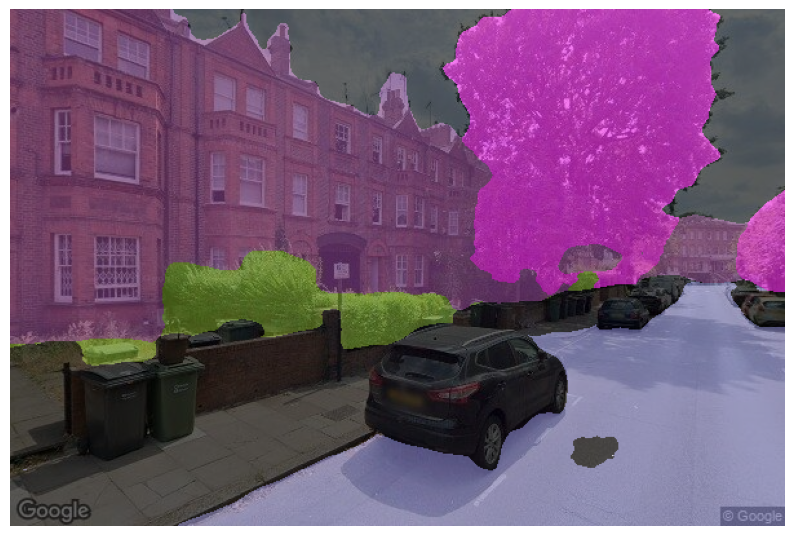

Unique classes in the segmentation map: [  0   1   2   4   6   7   8   9  10  11  14  17  20  22  32  38  41  43
  62  63 112 125 138]


In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the colors for each class
colors = {
    0: [0, 0, 0],        # Background
    1: [128, 64, 128],   # Building
    6: [128, 128, 192],  # Car
    17: [107, 142, 35],  # Tree
    4: [244, 35, 232],   # Sidewalk
    7: [255, 255, 255]   # Road
}

# Visualize the segmentation
colored_segmentation = np.zeros((predicted_labels.shape[0], predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, color in colors.items():
    colored_segmentation[predicted_labels == class_id] = color

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Debugging: Print unique classes in the segmentation map
unique_classes = np.unique(predicted_labels)
print("Unique classes in the segmentation map:", unique_classes)


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

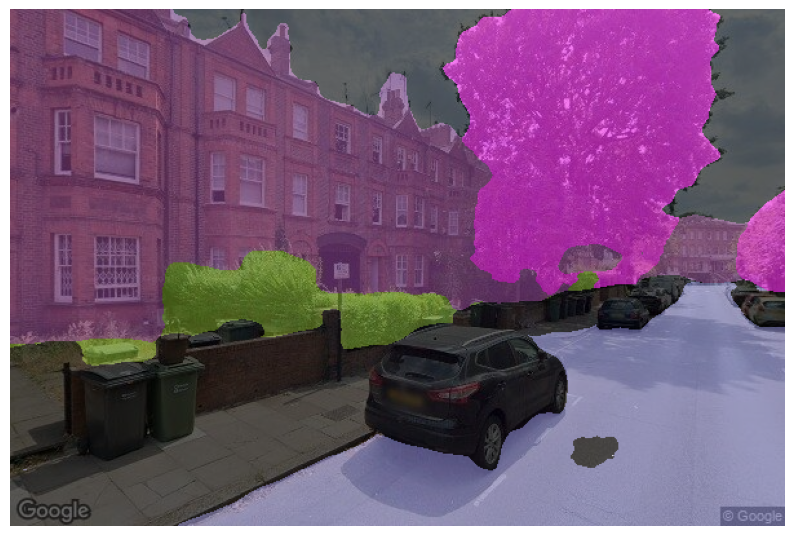

Unique classes in the segmentation map: [  0   1   2   4   6   7   8   9  10  11  14  17  20  22  32  38  41  43
  62  63 112 125 138]


In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the colors for each class
colors = {
    1: [128, 64, 128],   # Building
    6: [128, 128, 192],  # Car
    17: [107, 142, 35],  # Tree
    4: [244, 35, 232],   # Sidewalk
    7: [255, 255, 255]   # Road
}

# Map other classes to background
background_class = [0, 2, 8, 9, 10, 11, 14, 20, 22, 32, 38, 41, 43, 62, 63, 112, 125, 138]

# Visualize the segmentation
colored_segmentation = np.zeros((predicted_labels.shape[0], predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, color in colors.items():
    colored_segmentation[predicted_labels == class_id] = color
for class_id in background_class:
    colored_segmentation[predicted_labels == class_id] = [0, 0, 0]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Debugging: Print unique classes in the segmentation map
unique_classes = np.unique(predicted_labels)
print("Unique classes in the segmentation map:", unique_classes)


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Class 1: 30.62%
Class 6: 17.74%
Class 17: 4.54%
Class 4: 15.77%
Class 7: 0.00%


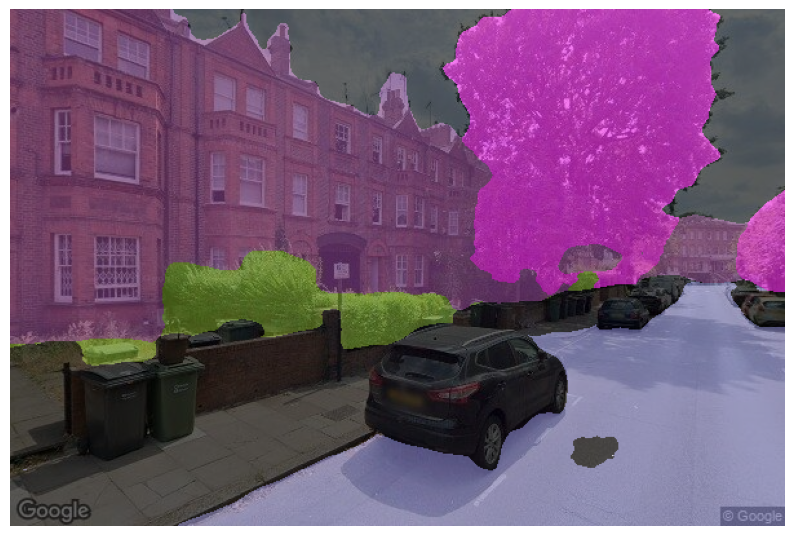

Unique classes in the segmentation map: [  0   1   2   4   6   7   8   9  10  11  14  17  20  22  32  38  41  43
  62  63 112 125 138]


In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the colors for each class
colors = {
    1: [128, 64, 128],   # Building
    6: [128, 128, 192],  # Car
    17: [107, 142, 35],  # Tree
    4: [244, 35, 232],   # Sidewalk
    7: [255, 255, 255]   # Road
}

# Calculate percentage for each class
total_pixels = predicted_labels.size
percentages = {class_id: np.sum(predicted_labels == class_id) / total_pixels * 100 for class_id in colors.keys()}

# Print the percentages
for class_id, percentage in percentages.items():
    print(f"Class {class_id}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((predicted_labels.shape[0], predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, color in colors.items():
    colored_segmentation[predicted_labels == class_id] = color

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Debugging: Print unique classes in the segmentation map
unique_classes = np.unique(predicted_labels)
print("Unique classes in the segmentation map:", unique_classes)


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Building: 30.62%
Car: 17.74%
Tree: 4.54%
Sidewalk: 15.77%
Road: 0.00%


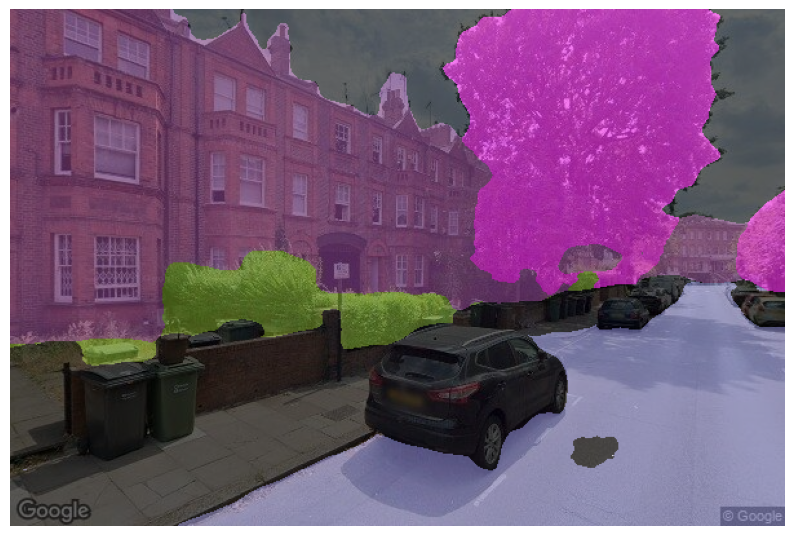

Unique classes in the segmentation map: [  0   1   2   4   6   7   8   9  10  11  14  17  20  22  32  38  41  43
  62  63 112 125 138]


In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the colors and names for each class
classes = {
    1: {"name": "Building", "color": [128, 64, 128]},
    6: {"name": "Car", "color": [128, 128, 192]},
    17: {"name": "Tree", "color": [107, 142, 35]},
    4: {"name": "Sidewalk", "color": [244, 35, 232]},
    7: {"name": "Road", "color": [255, 255, 255]}
}

# Calculate percentage for each class
total_pixels = predicted_labels.size
percentages = {class_id: np.sum(predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((predicted_labels.shape[0], predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Debugging: Print unique classes in the segmentation map
unique_classes = np.unique(predicted_labels)
print("Unique classes in the segmentation map:", unique_classes)


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


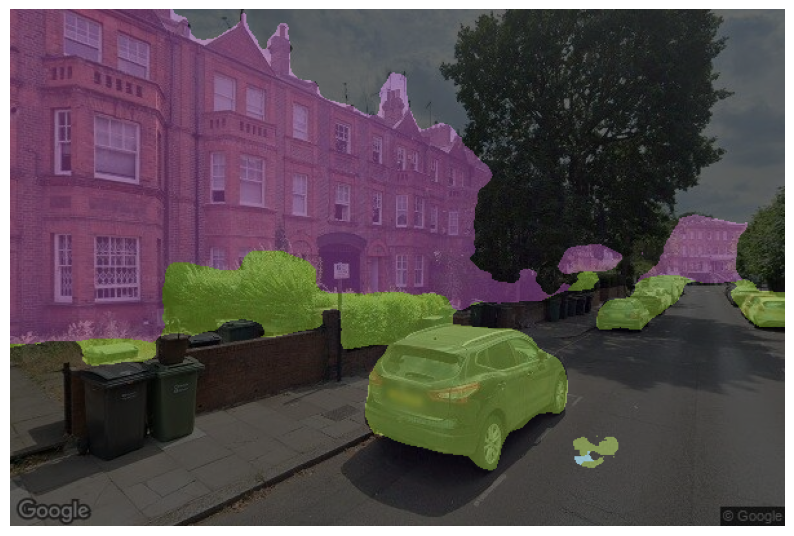

In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


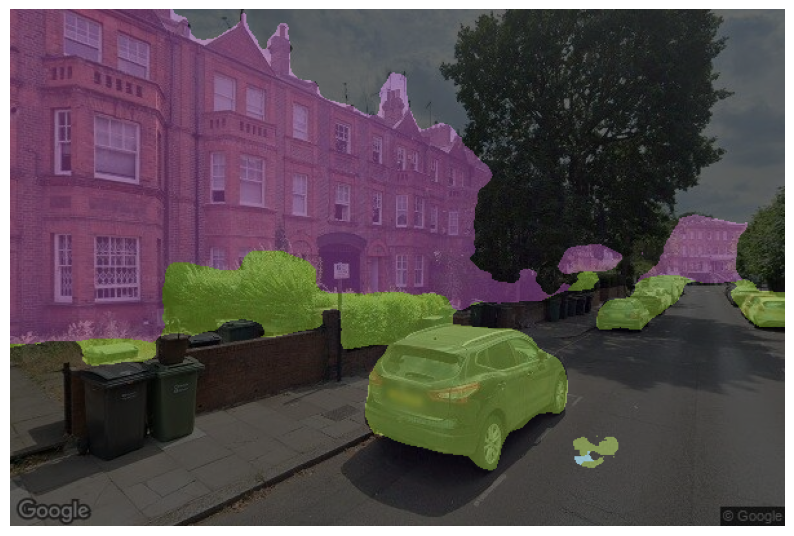

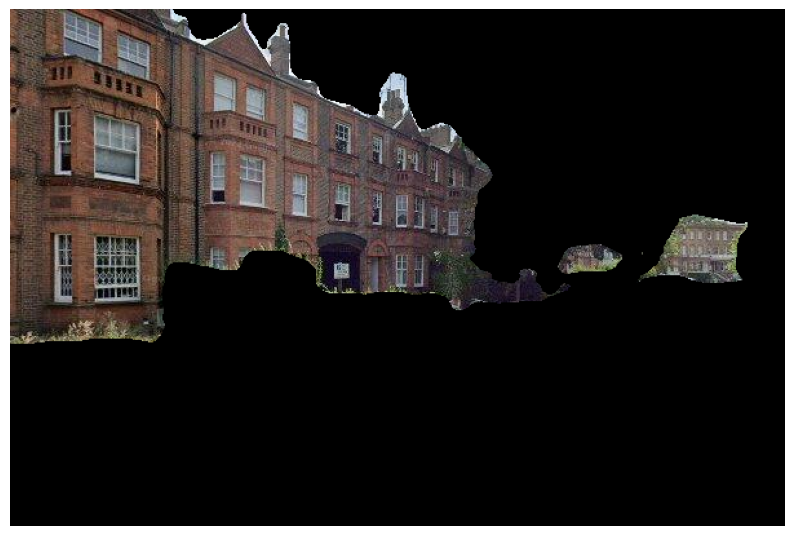

ValueError: in user code:

    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2440, in predict_function  *
        return step_function(self, iterator)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2425, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2413, in run_step  **
        outputs = model.predict_step(data)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2381, in predict_step
        return self(x, training=False)
    File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/input_spec.py", line 298, in assert_input_compatibility
        raise ValueError(

    ValueError: Input 0 of layer "sequential" is incompatible with the layer: expected shape=(None, 128, 128, 3), found shape=(None, 224, 224, 3)


In [ ]:
import tensorflow as tf

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.keras')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess the building segment for the material classifier
building_array = np.array(building_image.resize((224, 224))) / 255.0
building_array = np.expand_dims(building_array, axis=0)

# Apply the material classification model to the building segment
material_predictions = classifier_model.predict(building_array)
material_class = np.argmax(material_predictions, axis=1)

# Print the material classification result
print(f"Predicted material class for the building segment: {material_class}")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


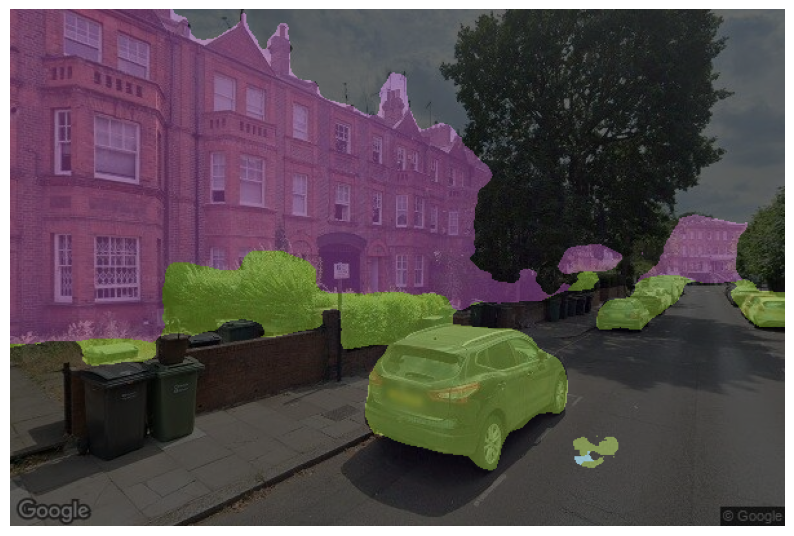

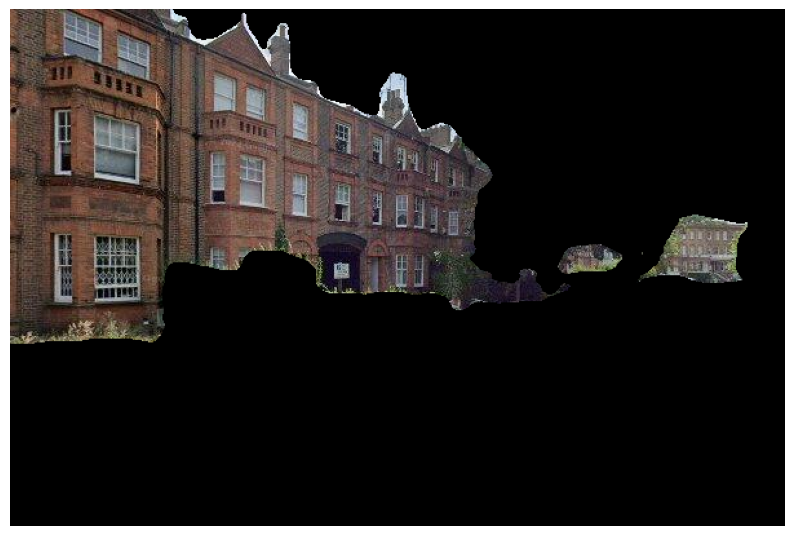

1/1 [==============================] - 0s 80ms/step
Predicted material class for the building segment: wood


In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
import tensorflow as tf

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier_0624.keras')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess the building segment for the material classifier
building_array = np.array(building_image.resize((128, 128))) / 255.0  # Resize to 128x128
building_array = np.expand_dims(building_array, axis=0)

# Apply the material classification model to the building segment
material_predictions = classifier_model.predict(building_array)
material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_class = material_classes[np.argmax(material_predictions, axis=1)[0]]

# Print the material classification result
print(f"Predicted material class for the building segment: {material_class}")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


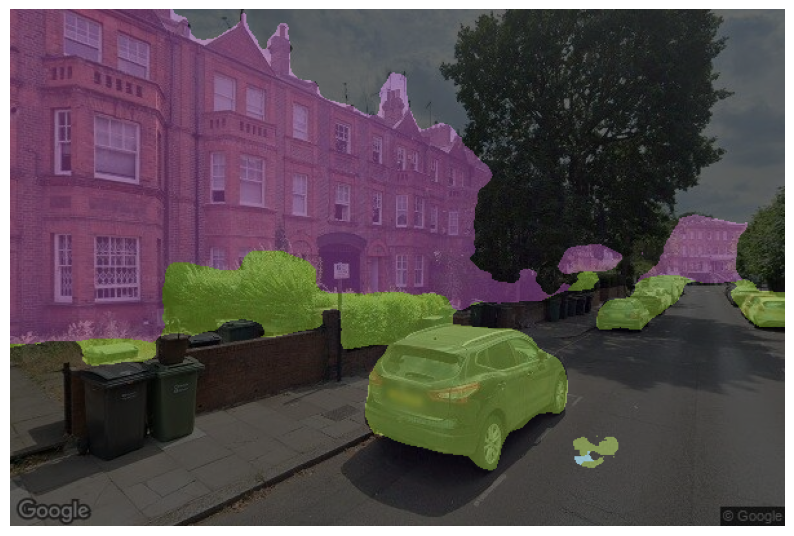

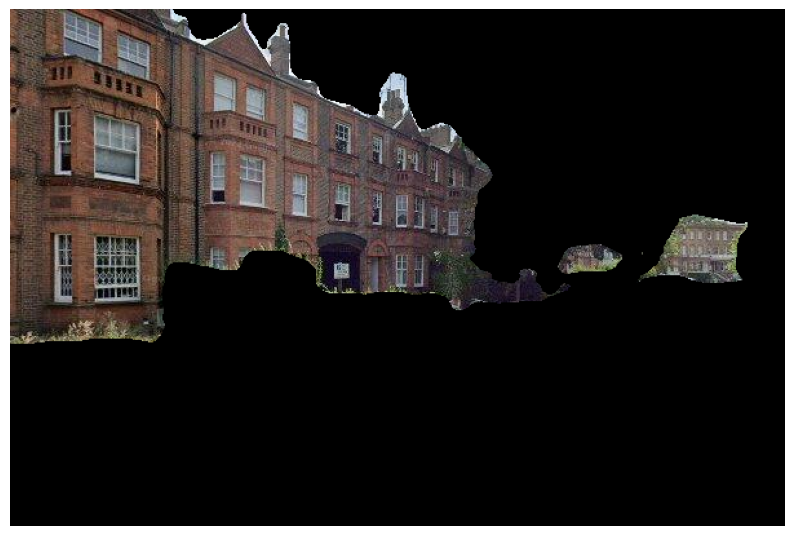

Patches shape: (8, 128, 128, 3)
1/1 [==============================] - 0s 82ms/step
Material predictions shape: (8, 11)
Argmax index: 2, Prediction: [1.4792235e-01 3.3911712e-02 5.8781737e-01 4.1287404e-02 1.2707039e-04
 8.6359894e-03 8.2747480e-03 7.4528322e-02 2.4425887e-02 1.2590611e-02
 6.0478590e-02]
Argmax index: 0, Prediction: [6.4426786e-01 7.8677475e-02 5.6689598e-02 4.0963706e-02 2.4343647e-06
 7.0332740e-03 6.1827269e-04 3.7198454e-02 5.3920045e-02 1.0751999e-03
 7.9553746e-02]
Argmax index: 3, Prediction: [1.6278997e-02 1.0389674e-02 4.0637660e-01 4.5215717e-01 9.2488226e-06
 1.4946131e-02 2.0234454e-02 7.5009661e-03 3.4290649e-02 1.2563389e-02
 2.5252672e-02]
Argmax index: 2, Prediction: [9.4497912e-03 4.4584498e-03 8.9393562e-01 4.8107214e-02 1.9738050e-06
 4.3684207e-03 4.6556150e-03 1.6847786e-02 1.0746692e-02 5.7120118e-03
 1.7163996e-03]
Argmax index: 2, Prediction: [1.0816680e-02 5.8433530e-03 8.9045113e-01 2.9015834e-02 9.1674028e-06
 2.7020460e-03 4.1719400e-03 2.3

In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
import tensorflow as tf

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.keras')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess patches from the building segment for the material classifier
patch_size = 128
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, patch_size):
    for j in range(0, w - patch_size + 1, patch_size):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = {material: 0 for material in material_classes}

for pred in material_predictions:
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (count / total_building_patches) * 100 for material, count in material_counts.items()}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


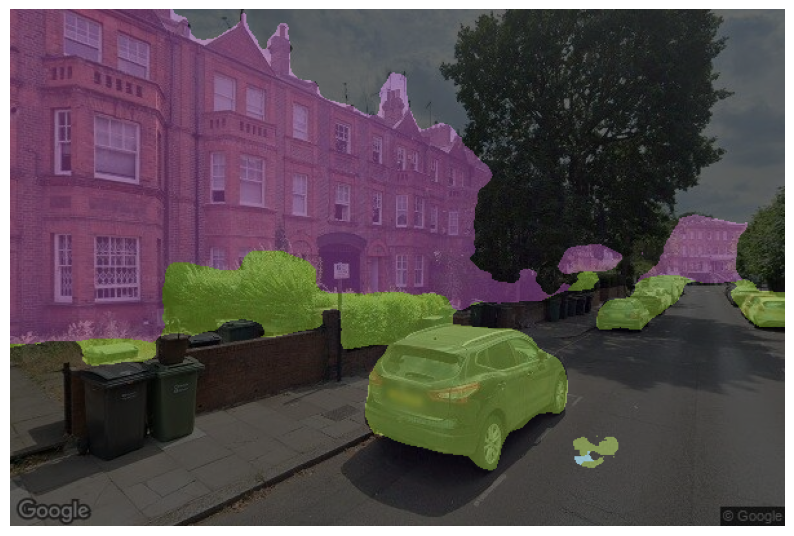

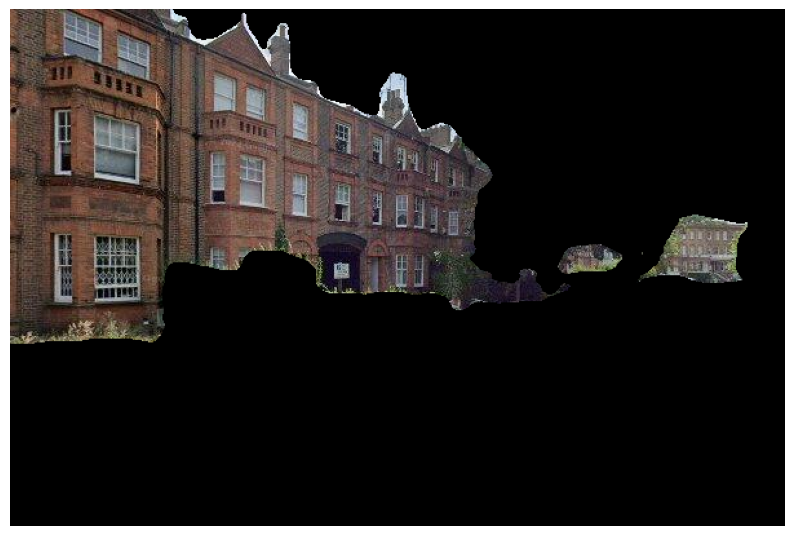

Patches shape: (32, 128, 128, 3)


1/1 [==============================] - 0s 289ms/step
Material predictions shape: (32, 11)
Argmax index: 2, Prediction: [1.4792231e-01 3.3911705e-02 5.8781737e-01 4.1287404e-02 1.2707053e-04
 8.6359940e-03 8.2747508e-03 7.4528307e-02 2.4425898e-02 1.2590618e-02
 6.0478609e-02]
Argmax index: 2, Prediction: [4.5044784e-02 5.9176078e-03 8.6638975e-01 1.2634118e-02 2.5170152e-07
 1.3793389e-04 9.2824957e-05 6.3145295e-02 3.5153546e-03 1.1863151e-03
 1.9357105e-03]
Argmax index: 0, Prediction: [6.4426792e-01 7.8677446e-02 5.6689601e-02 4.0963709e-02 2.4343624e-06
 7.0332745e-03 6.1827275e-04 3.7198447e-02 5.3920023e-02 1.0751995e-03
 7.9553701e-02]
Argmax index: 2, Prediction: [7.3258072e-02 7.2504603e-04 7.9699343e-01 9.1104090e-02 2.6519550e-07
 2.9222199e-04 2.4836739e-03 6.2488755e-03 9.3428493e-03 5.1801756e-04
 1.9033454e-02]
Argmax index: 3, Prediction: [1.6278999e-02 1.0389676e-02 4.0637666e-01 4.5215714e-01 9.2488299e-06
 1.4946129e-02 2.0234453e-02 7.5009689e-03 3.4290645e-02 1.256

In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.keras')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
patch_size = 128
stride = patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, stride):
    for j in range(0, w - patch_size + 1, stride):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)

for pred in material_predictions:
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (count / total_building_patches) * 100 for material, count in material_counts.items()}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


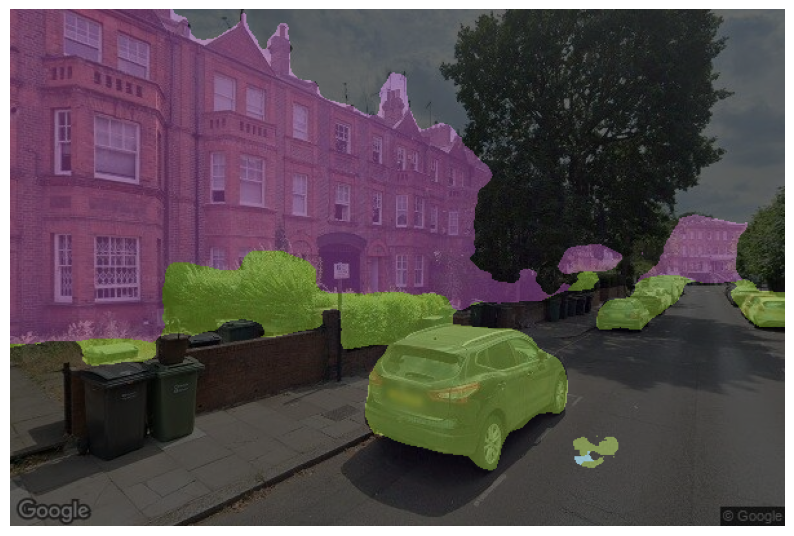

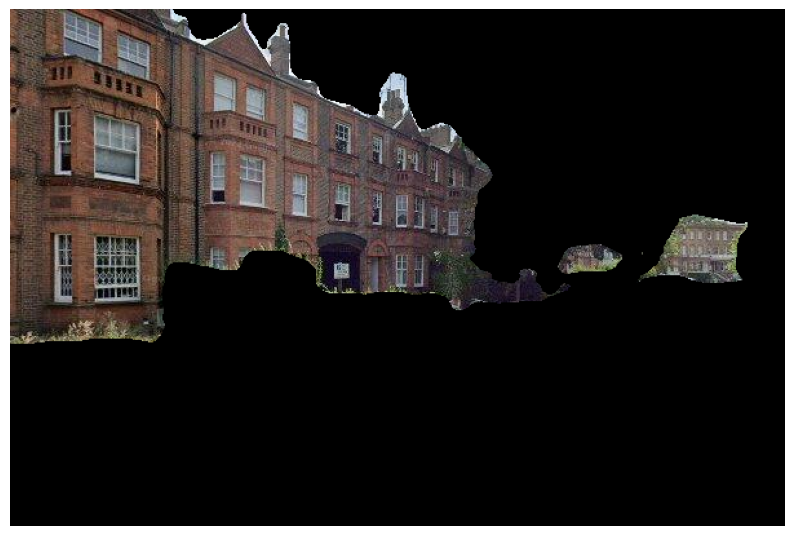

Patches shape: (32, 128, 128, 3)
1/1 [==============================] - 0s 85ms/step
Material predictions shape: (32, 11)
Argmax index: 2, Prediction: [1.4792231e-01 3.3911705e-02 5.8781737e-01 4.1287404e-02 1.2707053e-04
 8.6359940e-03 8.2747508e-03 7.4528307e-02 2.4425898e-02 1.2590618e-02
 6.0478609e-02]
Argmax index: 2, Prediction: [4.5044784e-02 5.9176078e-03 8.6638975e-01 1.2634118e-02 2.5170152e-07
 1.3793389e-04 9.2824957e-05 6.3145295e-02 3.5153546e-03 1.1863151e-03
 1.9357105e-03]
Argmax index: 0, Prediction: [6.4426792e-01 7.8677446e-02 5.6689601e-02 4.0963709e-02 2.4343624e-06
 7.0332745e-03 6.1827275e-04 3.7198447e-02 5.3920023e-02 1.0751995e-03
 7.9553701e-02]
Argmax index: 2, Prediction: [7.3258072e-02 7.2504603e-04 7.9699343e-01 9.1104090e-02 2.6519550e-07
 2.9222199e-04 2.4836739e-03 6.2488755e-03 9.3428493e-03 5.1801756e-04
 1.9033454e-02]
Argmax index: 3, Prediction: [1.6278999e-02 1.0389676e-02 4.0637666e-01 4.5215714e-01 9.2488299e-06
 1.4946129e-02 2.0234453e-02 7

In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.keras')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
patch_size = 128
stride = patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, stride):
    for j in range(0, w - patch_size + 1, stride):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)

for pred in material_predictions:
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (count / total_building_patches) * 100 for material, count in material_counts.items()}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


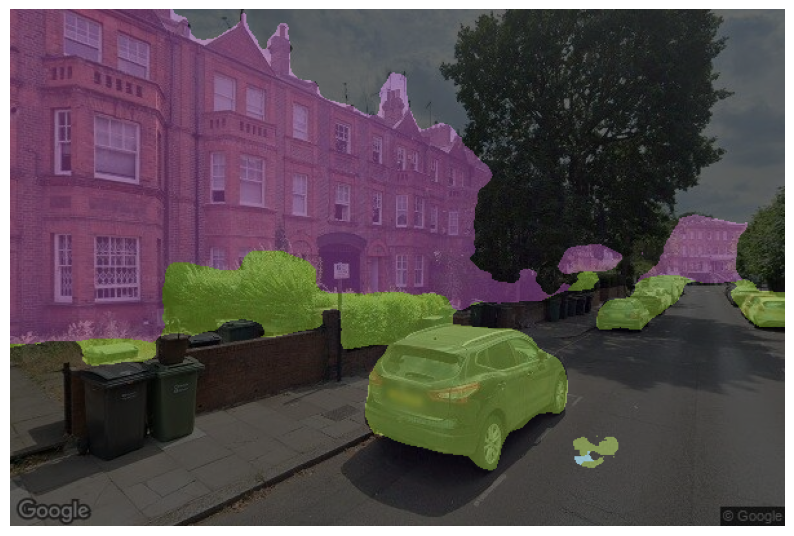

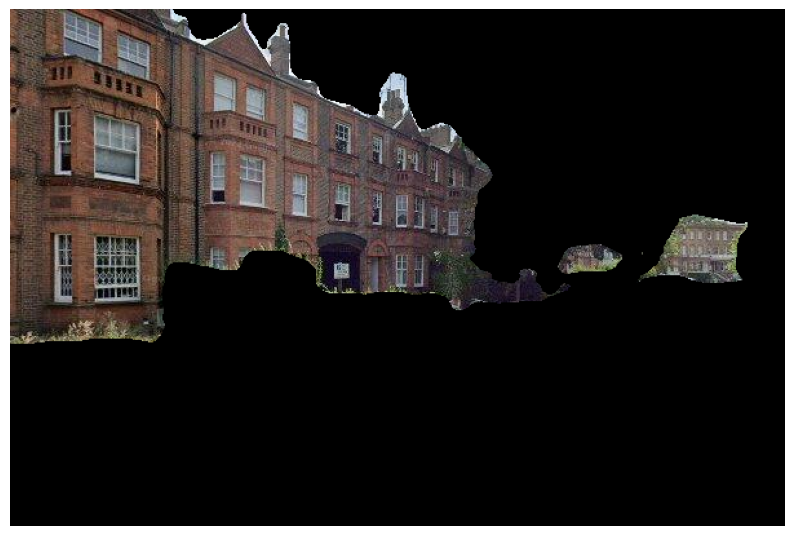

Patches shape: (32, 128, 128, 3)
1/1 [==============================] - 0s 81ms/step
Material predictions shape: (32, 11)
Argmax index: 2, Prediction: [1.4792231e-01 3.3911705e-02 5.8781737e-01 4.1287404e-02 1.2707053e-04
 8.6359940e-03 8.2747508e-03 7.4528307e-02 2.4425898e-02 1.2590618e-02
 6.0478609e-02]
Argmax index: 2, Prediction: [4.5044784e-02 5.9176078e-03 8.6638975e-01 1.2634118e-02 2.5170152e-07
 1.3793389e-04 9.2824957e-05 6.3145295e-02 3.5153546e-03 1.1863151e-03
 1.9357105e-03]
Argmax index: 0, Prediction: [6.4426792e-01 7.8677446e-02 5.6689601e-02 4.0963709e-02 2.4343624e-06
 7.0332745e-03 6.1827275e-04 3.7198447e-02 5.3920023e-02 1.0751995e-03
 7.9553701e-02]
Argmax index: 2, Prediction: [7.3258072e-02 7.2504603e-04 7.9699343e-01 9.1104090e-02 2.6519550e-07
 2.9222199e-04 2.4836739e-03 6.2488755e-03 9.3428493e-03 5.1801756e-04
 1.9033454e-02]
Argmax index: 3, Prediction: [1.6278999e-02 1.0389676e-02 4.0637666e-01 4.5215714e-01 9.2488299e-06
 1.4946129e-02 2.0234453e-02 7

In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
patch_size = 128
stride = patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, stride):
    for j in range(0, w - patch_size + 1, stride):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)

for pred in material_predictions:
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (count / total_building_patches) * 100 for material, count in material_counts.items()}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")



# Successful Hugging Face Segementation + Material Classification for the buildings only (on 1 Image)

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


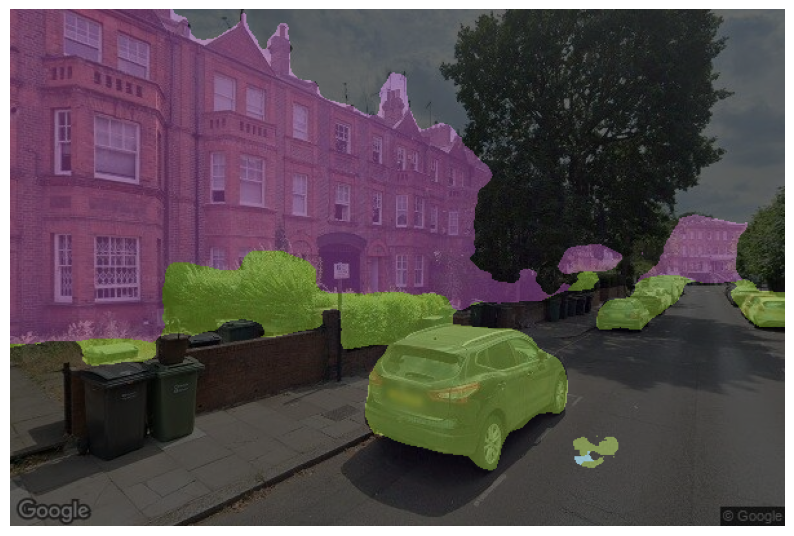

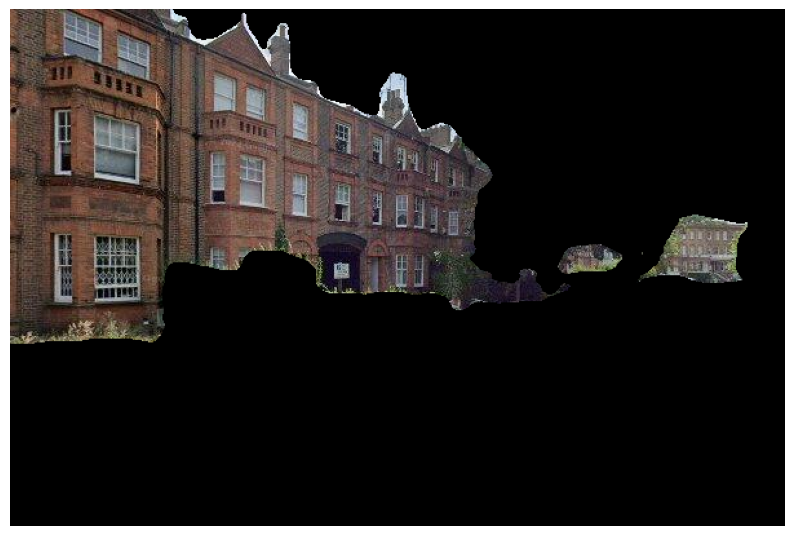

Patches shape: (32, 128, 128, 3)
1/1 [==============================] - 0s 85ms/step
Material predictions shape: (32, 11)
Argmax index: 2, Prediction: [1.4792231e-01 3.3911705e-02 5.8781737e-01 4.1287404e-02 1.2707053e-04
 8.6359940e-03 8.2747508e-03 7.4528307e-02 2.4425898e-02 1.2590618e-02
 6.0478609e-02]
Argmax index: 2, Prediction: [4.5044784e-02 5.9176078e-03 8.6638975e-01 1.2634118e-02 2.5170152e-07
 1.3793389e-04 9.2824957e-05 6.3145295e-02 3.5153546e-03 1.1863151e-03
 1.9357105e-03]
Argmax index: 0, Prediction: [6.4426792e-01 7.8677446e-02 5.6689601e-02 4.0963709e-02 2.4343624e-06
 7.0332745e-03 6.1827275e-04 3.7198447e-02 5.3920023e-02 1.0751995e-03
 7.9553701e-02]
Argmax index: 2, Prediction: [7.3258072e-02 7.2504603e-04 7.9699343e-01 9.1104090e-02 2.6519550e-07
 2.9222199e-04 2.4836739e-03 6.2488755e-03 9.3428493e-03 5.1801756e-04
 1.9033454e-02]
Argmax index: 3, Prediction: [1.6278999e-02 1.0389676e-02 4.0637666e-01 4.5215714e-01 9.2488299e-06
 1.4946129e-02 2.0234453e-02 7

In [ ]:
import requests
from PIL import Image
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    return img

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
patch_size = 128
stride = patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, stride):
    for j in range(0, w - patch_size + 1, stride):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = {material: 0 for material in material_classes}

for pred in material_predictions:
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (count / total_building_patches) * 100 for material, count in material_counts.items()}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")


## Visualize both the segementations and the Material classifications

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


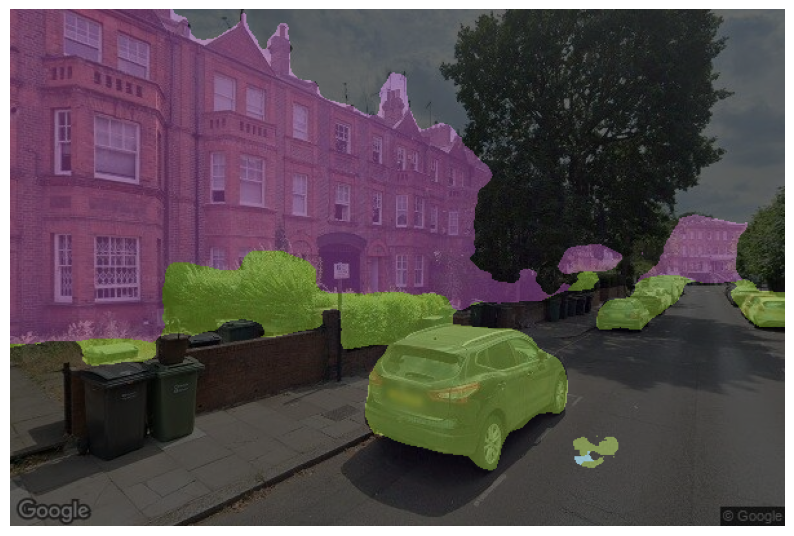

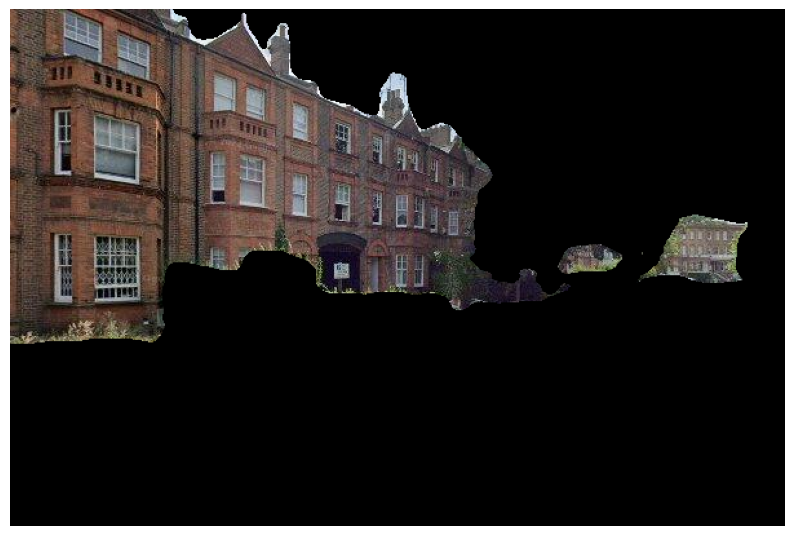

Patches shape: (32, 128, 128, 3)
1/1 [==============================] - 0s 86ms/step
Material predictions shape: (32, 11)
Argmax index: 2, Prediction: [1.4792231e-01 3.3911705e-02 5.8781737e-01 4.1287404e-02 1.2707053e-04
 8.6359940e-03 8.2747508e-03 7.4528307e-02 2.4425898e-02 1.2590618e-02
 6.0478609e-02]
Argmax index: 2, Prediction: [4.5044784e-02 5.9176078e-03 8.6638975e-01 1.2634118e-02 2.5170152e-07
 1.3793389e-04 9.2824957e-05 6.3145295e-02 3.5153546e-03 1.1863151e-03
 1.9357105e-03]
Argmax index: 0, Prediction: [6.4426792e-01 7.8677446e-02 5.6689601e-02 4.0963709e-02 2.4343624e-06
 7.0332745e-03 6.1827275e-04 3.7198447e-02 5.3920023e-02 1.0751995e-03
 7.9553701e-02]
Argmax index: 2, Prediction: [7.3258072e-02 7.2504603e-04 7.9699343e-01 9.1104090e-02 2.6519550e-07
 2.9222199e-04 2.4836739e-03 6.2488755e-03 9.3428493e-03 5.1801756e-04
 1.9033454e-02]
Argmax index: 3, Prediction: [1.6278999e-02 1.0389676e-02 4.0637666e-01 4.5215714e-01 9.2488299e-06
 1.4946129e-02 2.0234453e-02 7

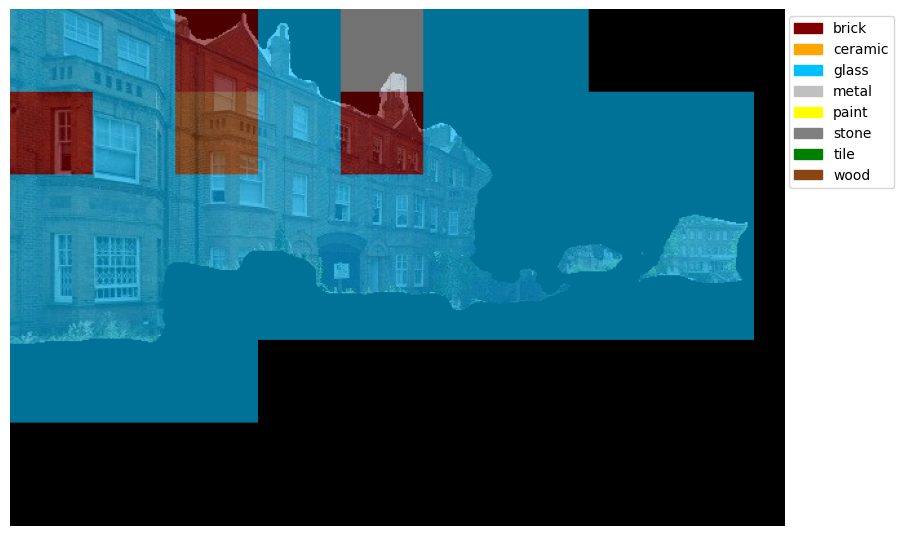

In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content)).convert("RGB")
        return img
    except requests.RequestException as e:
        print(f"Error downloading image: {e}")
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
if original_image is None:
    raise ValueError("Failed to download or identify the image.")

inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
patch_size = 128
stride = patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches and keep track of their coordinates
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, stride):
    for j in range(0, w - patch_size + 1, stride):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)
material_labels = np.zeros((h, w), dtype=int)

for idx, pred in enumerate(material_predictions):
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1
        # Assign material class to the corresponding patch
        i, j = patch_coords[idx]
        material_labels[i:i+patch_size, j:j+patch_size] = argmax_index + 1  # Use +1 to avoid 0 which is the background

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")

# Define colors for each material
material_colors = {
    'brick': [128, 0, 0],
    'ceramic': [255, 165, 0],
    'glass': [0, 191, 255],
    'metal': [192, 192, 192],
    'paint': [255, 255, 0],
    'stone': [128, 128, 128],
    'tile': [0, 128, 0],
    'wood': [139, 69, 19]
}

# Create a colored material classification map
colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_name in enumerate(material_classes, start=1):
    colored_materials[material_labels == class_id] = material_colors[class_name]

# Overlay the material classification on the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.imshow(colored_materials, alpha=0.6)
plt.axis('off')

# Create legend
legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

plt.show()


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


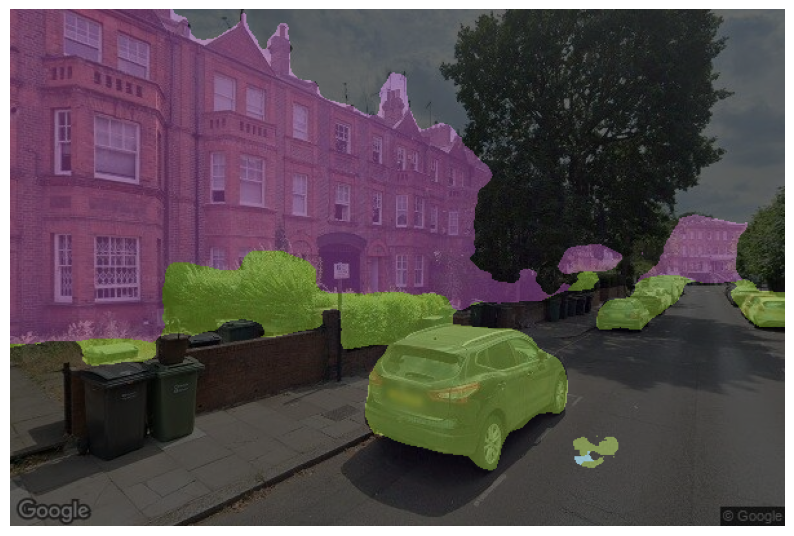

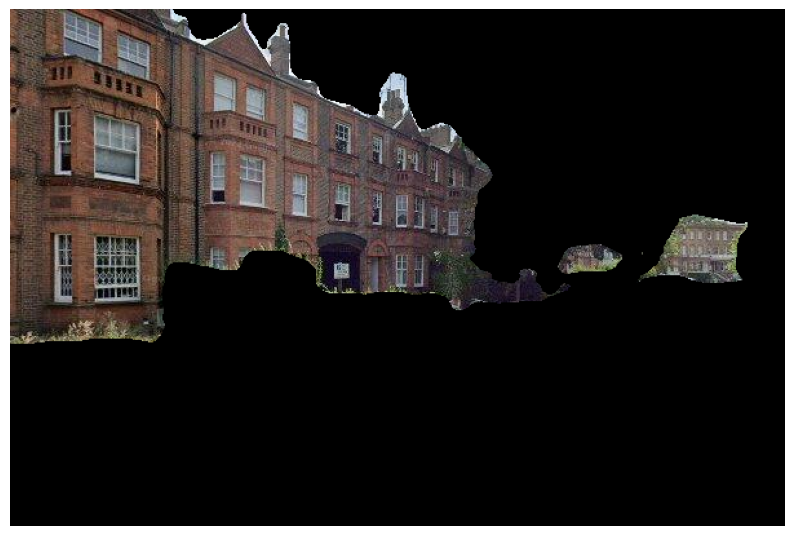

Patches shape: (32, 128, 128, 3)
1/1 [==============================] - 0s 84ms/step
Material predictions shape: (32, 11)
Argmax index: 2, Prediction: [1.4792231e-01 3.3911705e-02 5.8781737e-01 4.1287404e-02 1.2707053e-04
 8.6359940e-03 8.2747508e-03 7.4528307e-02 2.4425898e-02 1.2590618e-02
 6.0478609e-02]
Argmax index: 2, Prediction: [4.5044784e-02 5.9176078e-03 8.6638975e-01 1.2634118e-02 2.5170152e-07
 1.3793389e-04 9.2824957e-05 6.3145295e-02 3.5153546e-03 1.1863151e-03
 1.9357105e-03]
Argmax index: 0, Prediction: [6.4426792e-01 7.8677446e-02 5.6689601e-02 4.0963709e-02 2.4343624e-06
 7.0332745e-03 6.1827275e-04 3.7198447e-02 5.3920023e-02 1.0751995e-03
 7.9553701e-02]
Argmax index: 2, Prediction: [7.3258072e-02 7.2504603e-04 7.9699343e-01 9.1104090e-02 2.6519550e-07
 2.9222199e-04 2.4836739e-03 6.2488755e-03 9.3428493e-03 5.1801756e-04
 1.9033454e-02]
Argmax index: 3, Prediction: [1.6278999e-02 1.0389676e-02 4.0637666e-01 4.5215714e-01 9.2488299e-06
 1.4946129e-02 2.0234453e-02 7

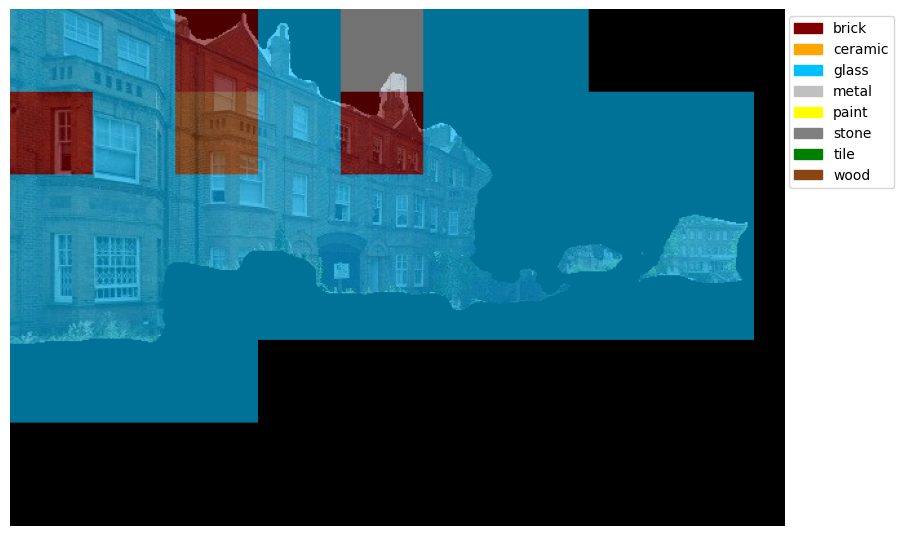

In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content)).convert("RGB")
        return img
    except requests.RequestException as e:
        print(f"Error downloading image: {e}")
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
if original_image is None:
    raise ValueError("Failed to download or identify the image.")

inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
patch_size = 128  # Required patch size for the classifier
stride = patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches and keep track of their coordinates
patches = []
patch_coords = []
for i in range(0, h - patch_size + 1, stride):
    for j in range(0, w - patch_size + 1, stride):
        patch = building_array[i:i+patch_size, j:j+patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patches.append(patch)
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)
material_labels = np.zeros((h, w), dtype=int)

for idx, pred in enumerate(material_predictions):
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1
        # Assign material class to the corresponding patch
        i, j = patch_coords[idx]
        material_labels[i:i+patch_size, j:j+patch_size] = argmax_index + 1  # Use +1 to avoid 0 which is the background

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")

# Define colors for each material
material_colors = {
    'brick': [128, 0, 0],
    'ceramic': [255, 165, 0],
    'glass': [0, 191, 255],
    'metal': [192, 192, 192],
    'paint': [255, 255, 0],
    'stone': [128, 128, 128],
    'tile': [0, 128, 0],
    'wood': [139, 69, 19]
}

# Create a colored material classification map
colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_name in enumerate(material_classes, start=1):
    colored_materials[material_labels == class_id] = material_colors[class_name]

# Overlay the material classification on the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.imshow(colored_materials, alpha=0.6)
plt.axis('off')

# Create legend
legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

plt.show()


### Patch Size 64

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


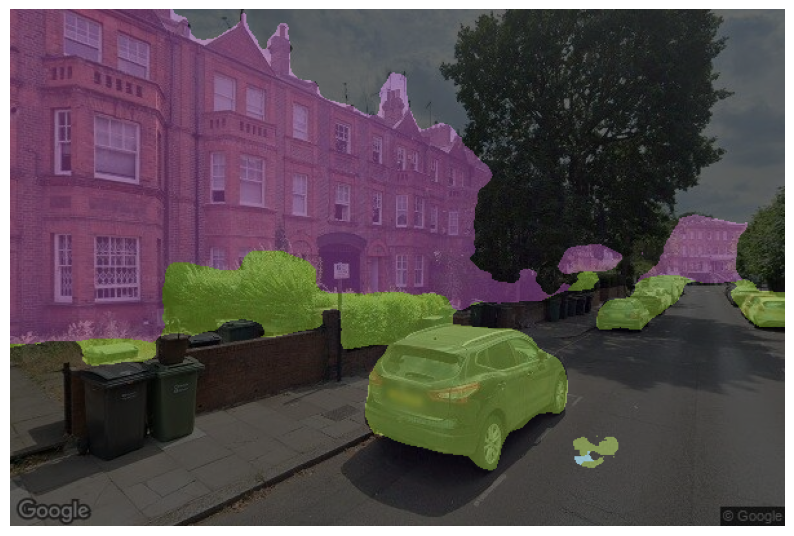

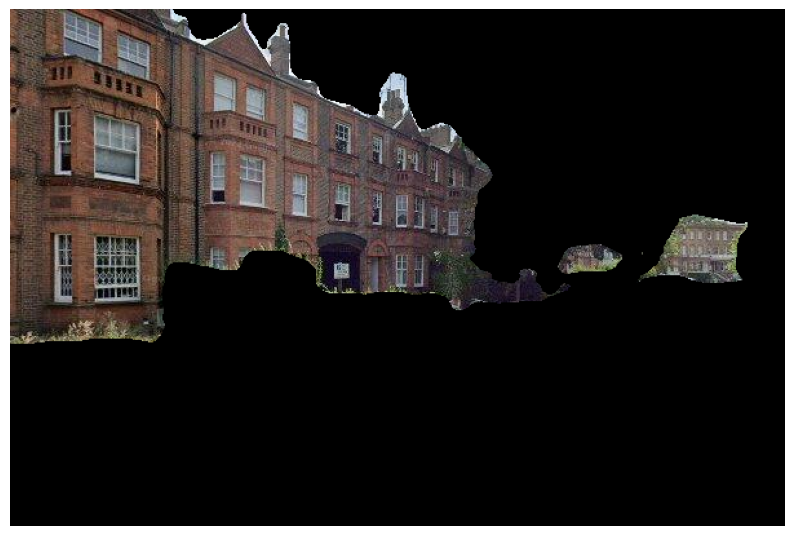

Patches shape: (110, 128, 128, 3)
4/4 [==============================] - 0s 54ms/step
Material predictions shape: (110, 11)
Argmax index: 10, Prediction: [0.22557908 0.09522793 0.12907101 0.02836765 0.00088133 0.03386574
 0.00390585 0.11085928 0.06121462 0.01508794 0.29593953]
Argmax index: 3, Prediction: [1.1386748e-02 2.9037416e-01 1.6941249e-01 3.1716275e-01 1.8924849e-04
 4.0239226e-02 7.0199021e-03 7.0866369e-02 1.9476622e-02 6.5687180e-02
 8.1852935e-03]
Argmax index: 1, Prediction: [0.04410091 0.2022138  0.16323268 0.17453258 0.00273233 0.08827391
 0.02484347 0.09759725 0.06666999 0.10891967 0.02688341]
Argmax index: 0, Prediction: [0.2764677  0.06510092 0.12994497 0.08075862 0.00090813 0.03126433
 0.01065985 0.12247661 0.09049542 0.01590756 0.17601588]
Argmax index: 0, Prediction: [3.4023410e-01 6.7478850e-02 1.2116481e-01 2.4782702e-02 1.1341752e-04
 8.4060701e-03 1.9145579e-03 1.7747171e-01 5.7158839e-02 2.0008767e-02
 1.8126613e-01]
Argmax index: 2, Prediction: [2.7512336e-0

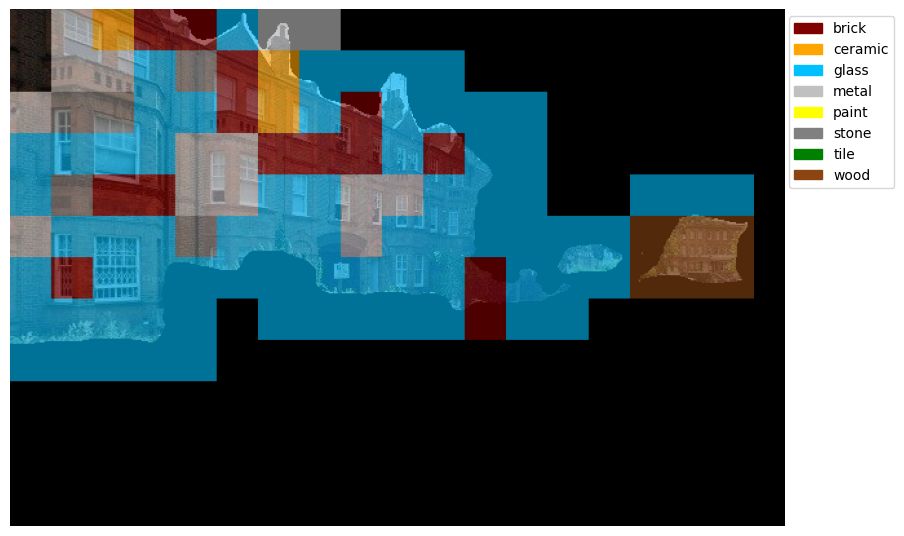

In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content)).convert("RGB")
        return img
    except requests.RequestException as e:
        print(f"Error downloading image: {e}")
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
if original_image is None:
    raise ValueError("Failed to download or identify the image.")

inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
small_patch_size = 64  # Smaller patch size
required_patch_size = 128  # Required patch size for the classifier
stride = small_patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches and keep track of their coordinates
patches = []
patch_coords = []
for i in range(0, h - small_patch_size + 1, stride):
    for j in range(0, w - small_patch_size + 1, stride):
        patch = building_array[i:i+small_patch_size, j:j+small_patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patch = Image.fromarray(patch).resize((required_patch_size, required_patch_size))  # Resize to 128x128
            patches.append(np.array(patch))
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)
material_labels = np.zeros((h, w), dtype=int)

for idx, pred in enumerate(material_predictions):
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1
        # Assign material class to the corresponding patch
        i, j = patch_coords[idx]
        material_labels[i:i+small_patch_size, j:j+small_patch_size] = argmax_index + 1  # Use +1 to avoid 0 which is the background

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")

# Define colors for each material
material_colors = {
    'brick': [128, 0, 0],
    'ceramic': [255, 165, 0],
    'glass': [0, 191, 255],
    'metal': [192, 192, 192],
    'paint': [255, 255, 0],
    'stone': [128, 128, 128],
    'tile': [0, 128, 0],
    'wood': [139, 69, 19]
}

# Create a colored material classification map
colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_name in enumerate(material_classes, start=1):
    colored_materials[material_labels == class_id] = material_colors[class_name]

# Overlay the material classification on the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.imshow(colored_materials, alpha=0.6)
plt.axis('off')

# Create legend
legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

plt.show()


## Patch Size 4

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


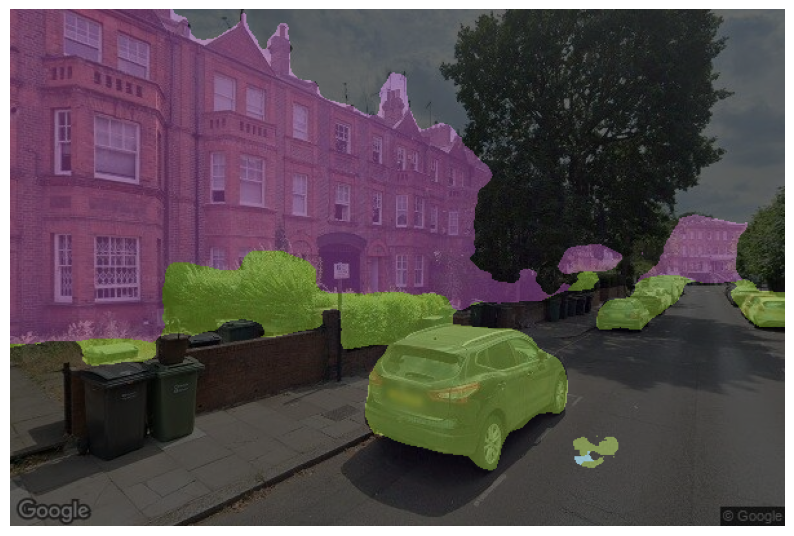

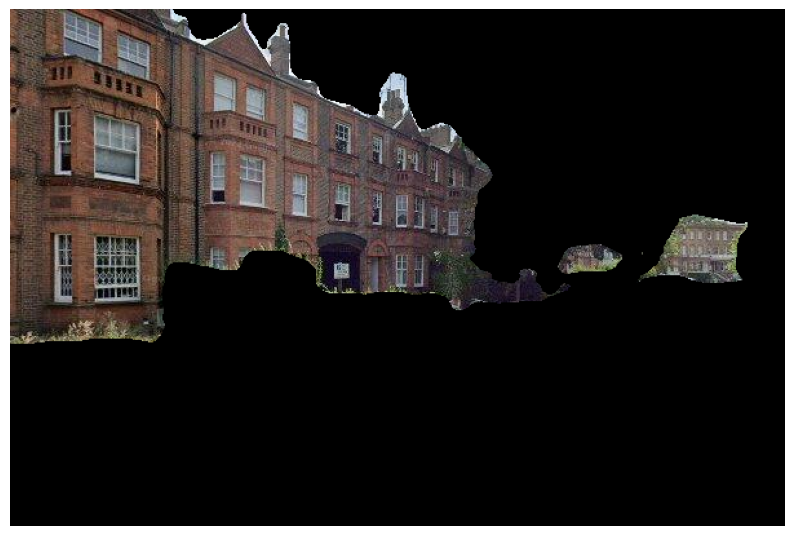

Streaming output truncated to the last 5000 lines.
 3.66706580e-01 2.25841980e-02 8.33184347e-02]
Argmax index: 5, Prediction: [4.85721976e-02 1.06574968e-01 1.17428927e-02 1.12734595e-02
 5.23167073e-05 3.42245191e-01 2.62095570e-03 3.97107191e-02
 3.19124669e-01 3.37114707e-02 8.43711421e-02]
Argmax index: 5, Prediction: [4.0912498e-02 1.2434538e-01 6.6107144e-03 1.3376073e-02 5.5514047e-05
 4.1617697e-01 5.3908434e-03 2.7963584e-02 2.7181113e-01 3.3018805e-02
 6.0338449e-02]
Argmax index: 5, Prediction: [3.5553884e-02 9.3040578e-02 6.0310932e-03 1.2325746e-02 2.5794294e-05
 4.3696138e-01 3.0753484e-03 2.0738745e-02 3.0807853e-01 1.6278416e-02
 6.7890570e-02]
Argmax index: 5, Prediction: [2.6070807e-02 4.5284793e-02 5.4395674e-03 1.2781811e-02 1.0476583e-05
 4.6751815e-01 2.1093856e-03 1.0681357e-02 3.4073073e-01 2.8269880e-03
 8.6545996e-02]
Argmax index: 10, Prediction: [6.1209552e-02 2.7582111e-02 1.2487933e-02 1.9852336e-02 2.5528178e-05
 1.9511122e-01 1.9597977e-03 2.3717444e-02

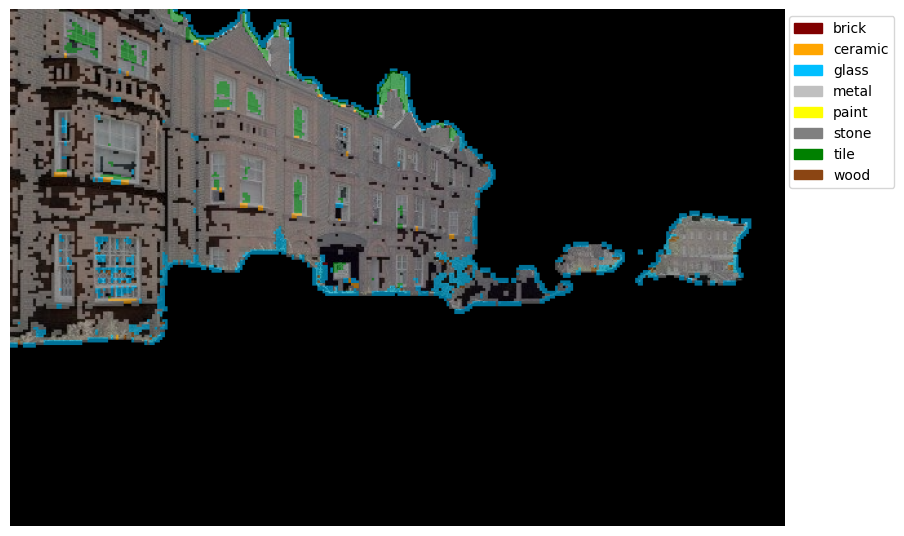

In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content)).convert("RGB")
        return img
    except requests.RequestException as e:
        print(f"Error downloading image: {e}")
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
if original_image is None:
    raise ValueError("Failed to download or identify the image.")

inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
small_patch_size = 4  # Smaller patch size
required_patch_size = 128  # Required patch size for the classifier
stride = small_patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches and keep track of their coordinates
patches = []
patch_coords = []
for i in range(0, h - small_patch_size + 1, stride):
    for j in range(0, w - small_patch_size + 1, stride):
        patch = building_array[i:i+small_patch_size, j:j+small_patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patch = Image.fromarray(patch).resize((required_patch_size, required_patch_size))  # Resize to 128x128
            patches.append(np.array(patch))
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'stone', 'tile', 'wood']
material_counts = defaultdict(int)
material_labels = np.zeros((h, w), dtype=int)

for idx, pred in enumerate(material_predictions):
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
        material_counts[material_class] += 1
        # Assign material class to the corresponding patch
        i, j = patch_coords[idx]
        material_labels[i:i+small_patch_size, j:j+small_patch_size] = argmax_index + 1  # Use +1 to avoid 0 which is the background

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")

# Define colors for each material
material_colors = {
    'brick': [128, 0, 0],
    'ceramic': [255, 165, 0],
    'glass': [0, 191, 255],
    'metal': [192, 192, 192],
    'paint': [255, 255, 0],
    'stone': [128, 128, 128],
    'tile': [0, 128, 0],
    'wood': [139, 69, 19]
}

# Create a colored material classification map
colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_name in enumerate(material_classes, start=1):
    colored_materials[material_labels == class_id] = material_colors[class_name]

# Overlay the material classification on the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.imshow(colored_materials, alpha=0.6)
plt.axis('off')

# Create legend
legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

plt.show()


## Merging Stone and Brick Classes

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


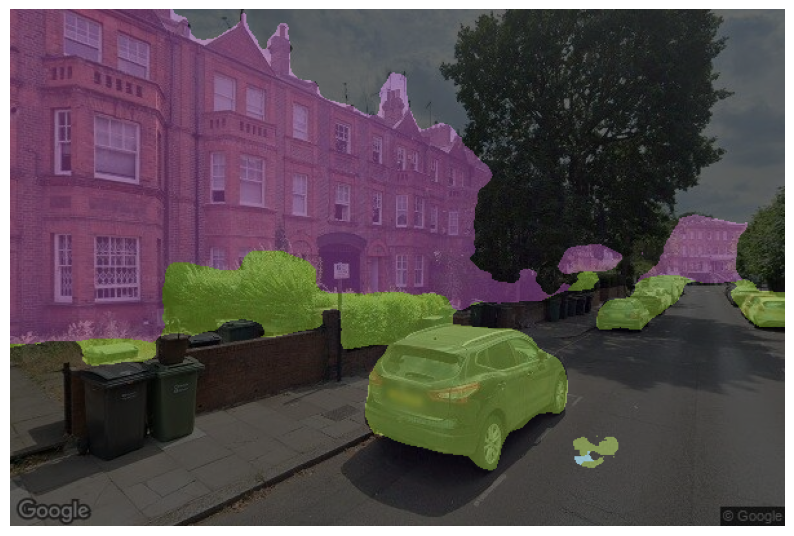

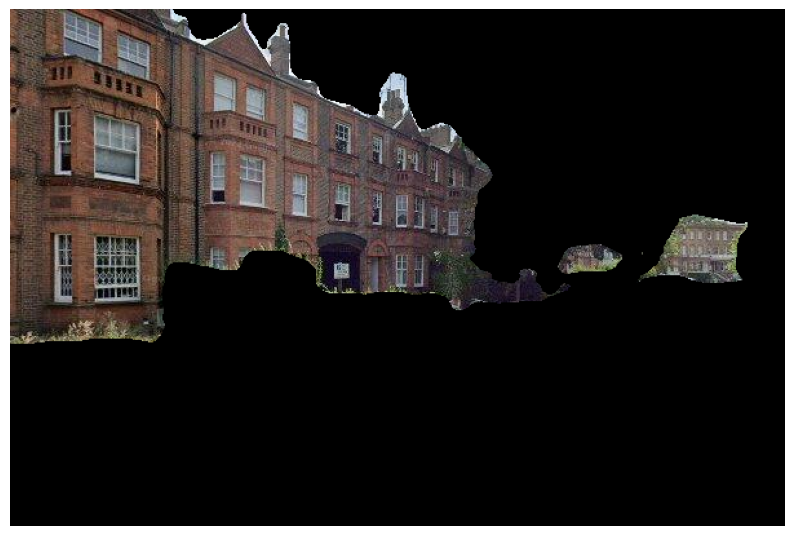

Streaming output truncated to the last 5000 lines.
 1.01588186e-04 3.30740869e-01 5.91842784e-03 3.41370292e-02
 3.66706580e-01 2.25841980e-02 8.33184347e-02]
Argmax index: 5, Prediction: [4.85721976e-02 1.06574968e-01 1.17428927e-02 1.12734595e-02
 5.23167073e-05 3.42245191e-01 2.62095570e-03 3.97107191e-02
 3.19124669e-01 3.37114707e-02 8.43711421e-02]
Argmax index: 5, Prediction: [4.0912498e-02 1.2434538e-01 6.6107144e-03 1.3376073e-02 5.5514047e-05
 4.1617697e-01 5.3908434e-03 2.7963584e-02 2.7181113e-01 3.3018805e-02
 6.0338449e-02]
Argmax index: 5, Prediction: [3.5553884e-02 9.3040578e-02 6.0310932e-03 1.2325746e-02 2.5794294e-05
 4.3696138e-01 3.0753484e-03 2.0738745e-02 3.0807853e-01 1.6278416e-02
 6.7890570e-02]
Argmax index: 5, Prediction: [2.6070807e-02 4.5284793e-02 5.4395674e-03 1.2781811e-02 1.0476583e-05
 4.6751815e-01 2.1093856e-03 1.0681357e-02 3.4073073e-01 2.8269880e-03
 8.6545996e-02]
Argmax index: 10, Prediction: [6.1209552e-02 2.7582111e-02 1.2487933e-02 1.9852336

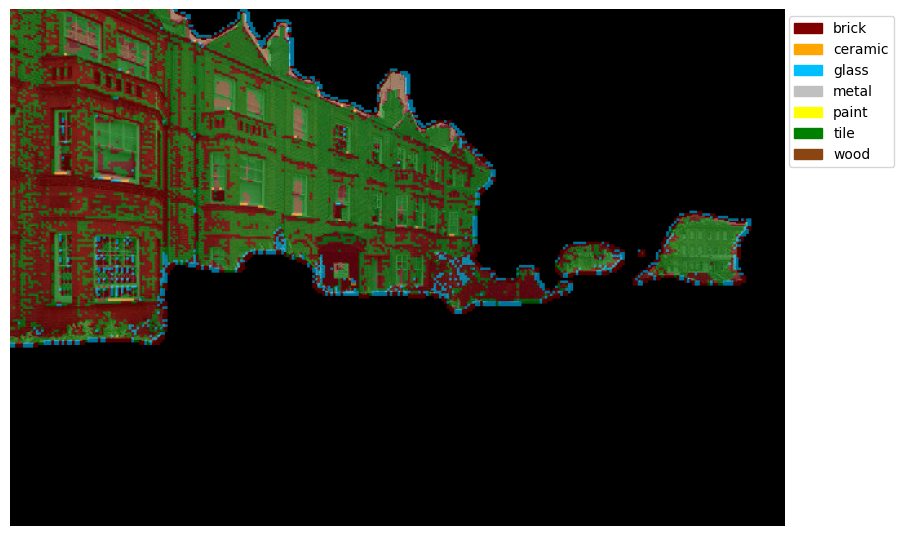

In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content)).convert("RGB")
        return img
    except requests.RequestException as e:
        print(f"Error downloading image: {e}")
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
if original_image is None:
    raise ValueError("Failed to download or identify the image.")

inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
small_patch_size = 4  # Smaller patch size
required_patch_size = 128  # Required patch size for the classifier
stride = small_patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches and keep track of their coordinates
patches = []
patch_coords = []
for i in range(0, h - small_patch_size + 1, stride):
    for j in range(0, w - small_patch_size + 1, stride):
        patch = building_array[i:i+small_patch_size, j:j+small_patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patch = Image.fromarray(patch).resize((required_patch_size, required_patch_size))  # Resize to 128x128
            patches.append(np.array(patch))
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'tile', 'wood']  # Merged stone into brick
material_counts = defaultdict(int)
material_labels = np.zeros((h, w), dtype=int)

for idx, pred in enumerate(material_predictions):
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
    else:
        # If argmax_index is out of range, assign it to the 'brick' class (merged with stone)
        material_class = 'brick'
    material_counts[material_class] += 1
    # Assign material class to the corresponding patch
    i, j = patch_coords[idx]
    material_labels[i:i+small_patch_size, j:j+small_patch_size] = material_classes.index(material_class) + 1  # Use +1 to avoid 0 which is the background

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")

# Define colors for each material
material_colors = {
    'brick': [128, 0, 0],
    'ceramic': [255, 165, 0],
    'glass': [0, 191, 255],
    'metal': [192, 192, 192],
    'paint': [255, 255, 0],
    'tile': [0, 128, 0],
    'wood': [139, 69, 19]
}

# Create a colored material classification map
colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_name in enumerate(material_classes, start=1):
    colored_materials[material_labels == class_id] = material_colors[class_name]

# Overlay the material classification on the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.imshow(colored_materials, alpha=0.6)
plt.axis('off')

# Create legend
legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

plt.show()


## Patch Size 16

Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Background: 58.28%
Foliage: 11.06%
Building: 30.62%
Sky: 0.03%


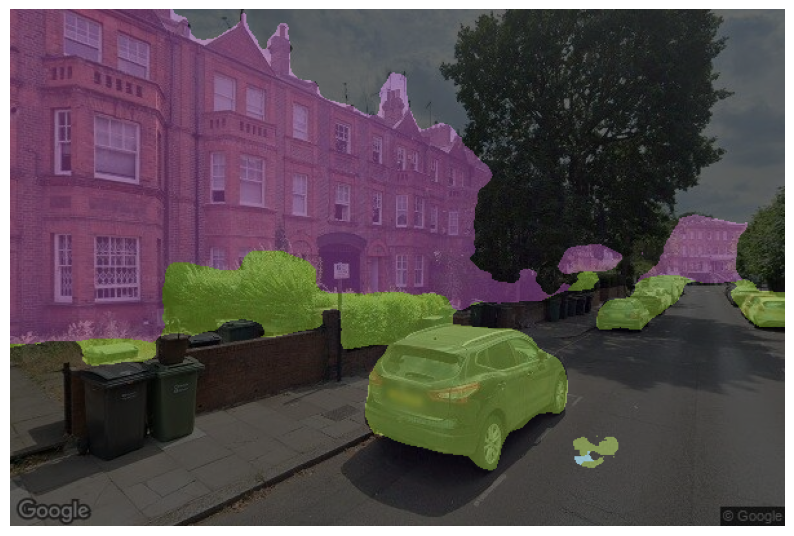

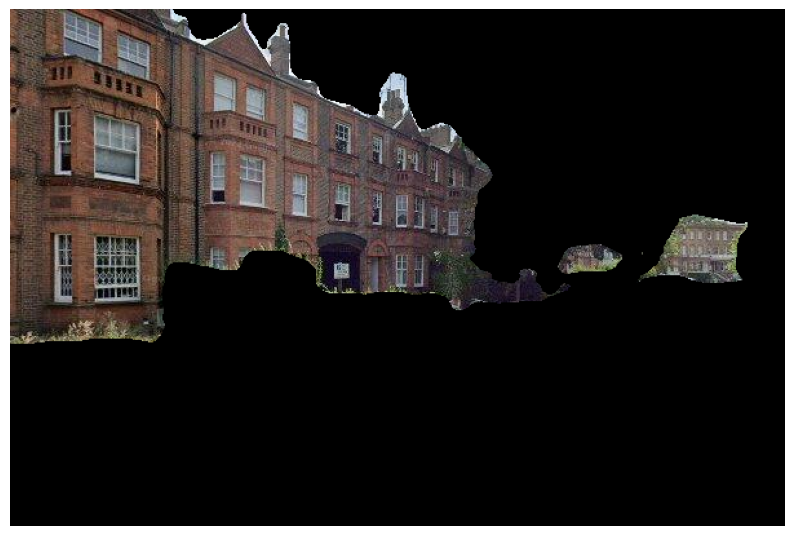

Patches shape: (1340, 128, 128, 3)
42/42 [==============================] - 0s 3ms/step
Material predictions shape: (1340, 11)
Argmax index: 10, Prediction: [6.4727835e-02 3.9048456e-02 1.5069286e-02 2.1002080e-02 4.4777466e-05
 1.9915549e-01 2.3381405e-03 2.6878772e-02 2.4675636e-01 2.0275330e-03
 3.8295126e-01]
Argmax index: 5, Prediction: [5.0314266e-02 5.0784595e-02 1.2456792e-02 2.3212150e-02 5.8458070e-05
 3.3496800e-01 3.6403837e-03 2.1568956e-02 2.9196897e-01 3.9364956e-03
 2.0709087e-01]
Argmax index: 5, Prediction: [5.2525047e-02 5.2722320e-02 1.7279686e-02 3.1568207e-02 7.7187069e-05
 3.1671715e-01 4.5213378e-03 2.4398442e-02 3.0466074e-01 3.6799163e-03
 1.9184998e-01]
Argmax index: 5, Prediction: [4.3159124e-02 4.1387737e-02 1.1913420e-02 2.7985172e-02 3.4753488e-05
 3.2959661e-01 2.4042549e-03 2.2127308e-02 2.6547801e-01 1.9437094e-03
 2.5396997e-01]
Argmax index: 5, Prediction: [6.0258768e-02 5.8410682e-02 1.0767834e-02 2.5152832e-02 8.3800893e-05
 3.6730555e-01 3.9526406

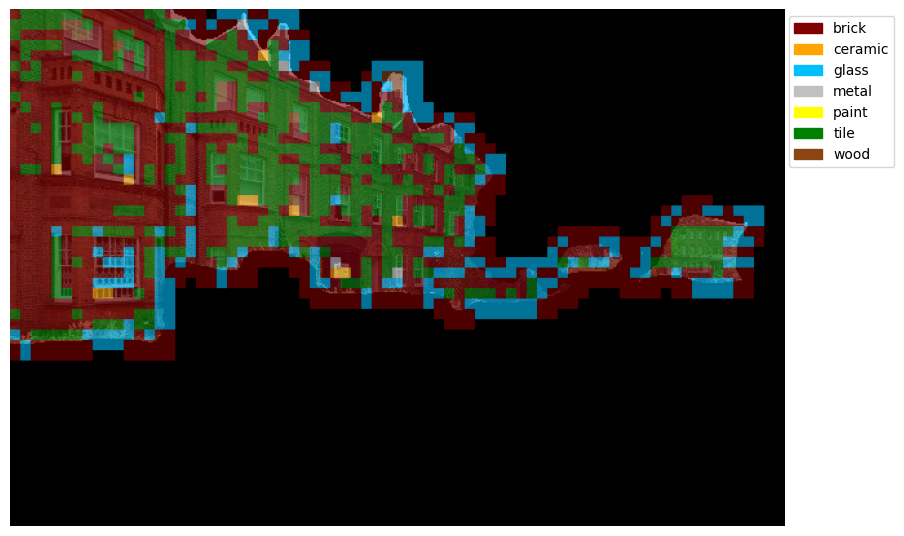

In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict

# Function to download and preprocess the image
def download_image(url):
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content)).convert("RGB")
        return img
    except requests.RequestException as e:
        print(f"Error downloading image: {e}")
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.h5')

# URL of the image to be segmented
image_url = "https://raw.githubusercontent.com/mohammadabid-macad/AIAStudioG03/main/images/building_(%27way%27%2C%20239812190)_heading_156.96565272670426.jpg"

# Download and preprocess the image
original_image = download_image(image_url)
if original_image is None:
    raise ValueError("Failed to download or identify the image.")

inputs = feature_extractor(images=original_image, return_tensors="pt")

# Perform segmentation
with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
    predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

# Define the class mappings
foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
building_class = 1
sky_class = 22

# Create a new map for the desired classes
new_predicted_labels = np.zeros_like(predicted_labels)

new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
new_predicted_labels[predicted_labels == building_class] = 2  # Building
new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

# Define the colors and names for each class
classes = {
    0: {"name": "Background", "color": [0, 0, 0]},
    1: {"name": "Foliage", "color": [107, 142, 35]},
    2: {"name": "Building", "color": [128, 64, 128]},
    3: {"name": "Sky", "color": [135, 206, 235]}
}

# Calculate percentage for each class
total_pixels = new_predicted_labels.size
percentages = {class_id: np.sum(new_predicted_labels == class_id) / total_pixels * 100 for class_id in classes.keys()}

# Print the percentages with class names
for class_id, percentage in percentages.items():
    print(f"{classes[class_id]['name']}: {percentage:.2f}%")

# Visualize the segmentation
colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_info in classes.items():
    colored_segmentation[new_predicted_labels == class_id] = class_info["color"]

plt.figure(figsize=(10, 10))
plt.imshow(original_image)
plt.imshow(colored_segmentation, alpha=0.6)
plt.axis('off')
plt.show()

# Extract the building segment
building_mask = (new_predicted_labels == 2)
building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

# Convert the building segment back to an image
building_image = Image.fromarray(building_segment.astype('uint8'))

# Visualize the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.axis('off')
plt.show()

# Preprocess overlapping patches from the building segment for the material classifier
small_patch_size = 16  # Adjusted patch size
required_patch_size = 128  # Required patch size for the classifier
stride = small_patch_size // 2  # 50% overlap
building_array = np.array(building_image)
h, w, _ = building_array.shape

# Extract patches and keep track of their coordinates
patches = []
patch_coords = []
for i in range(0, h - small_patch_size + 1, stride):
    for j in range(0, w - small_patch_size + 1, stride):
        patch = building_array[i:i+small_patch_size, j:j+small_patch_size]
        if np.sum(patch) > 0:  # Avoid patches with only background
            patch = Image.fromarray(patch).resize((required_patch_size, required_patch_size))  # Resize to 128x128
            patches.append(np.array(patch))
            patch_coords.append((i, j))

patches = np.array(patches) / 255.0

# Debugging: Print the shape of the patches
print(f"Patches shape: {patches.shape}")

# Classify each patch
material_predictions = classifier_model.predict(patches)

# Debugging: Print the shape of the predictions
print(f"Material predictions shape: {material_predictions.shape}")

material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'tile', 'wood']  # Merged stone into brick
material_counts = defaultdict(int)
material_labels = np.zeros((h, w), dtype=int)

for idx, pred in enumerate(material_predictions):
    argmax_index = np.argmax(pred)
    # Debugging: Print the argmax index and the corresponding prediction
    print(f"Argmax index: {argmax_index}, Prediction: {pred}")
    if argmax_index < len(material_classes):
        material_class = material_classes[argmax_index]
    else:
        # If argmax_index is out of range, assign it to the 'brick' class (merged with stone)
        material_class = 'brick'
    material_counts[material_class] += 1
    # Assign material class to the corresponding patch
    i, j = patch_coords[idx]
    material_labels[i:i+small_patch_size, j:j+small_patch_size] = material_classes.index(material_class) + 1  # Use +1 to avoid 0 which is the background

# Calculate percentages for each material in the building segment
total_building_patches = len(patches)
material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

# Print the material classification results with percentages
for material, percentage in material_percentages.items():
    print(f"{material}: {percentage:.2f}%")

# Define colors for each material
material_colors = {
    'brick': [128, 0, 0],
    'ceramic': [255, 165, 0],
    'glass': [0, 191, 255],
    'metal': [192, 192, 192],
    'paint': [255, 255, 0],
    'tile': [0, 128, 0],
    'wood': [139, 69, 19]
}

# Create a colored material classification map
colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
for class_id, class_name in enumerate(material_classes, start=1):
    colored_materials[material_labels == class_id] = material_colors[class_name]

# Overlay the material classification on the building segment
plt.figure(figsize=(10, 10))
plt.imshow(building_image)
plt.imshow(colored_materials, alpha=0.6)
plt.axis('off')

# Create legend
legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

plt.show()


# Final Code for Running the Segementation (Hugging Face Deeplearn) and Material Classification (32 patches) to the entire Images Dataset

In [ ]:
import os
import random
import requests
import pandas as pd
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTFeatureExtractor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict


In [ ]:
import requests
from PIL import Image, UnidentifiedImageError
import torch
from transformers import DPTImageProcessor, DPTForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from io import BytesIO
import tensorflow as tf
from collections import defaultdict
import os
import pandas as pd
import random

# Function to read and preprocess the image from local path
def read_image(path):
    try:
        img = Image.open(path).convert("RGB")
        return img
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTImageProcessor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Load your material texture classifier model
classifier_model = tf.keras.models.load_model('/content/drive/Shareddrives/Iaac_AIA24/STUDIO/material_texture_classifier.keras')

# Path to your dataset
dataset_path = '/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/v8'
output_path = '/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/processed_results'

# Ensure the output directory exists
os.makedirs(output_path, exist_ok=True)

# Get list of image files in the dataset
image_files = [f for f in os.listdir(dataset_path) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Initialize a DataFrame to store the results
columns = ['image'] + ['brick', 'ceramic', 'glass', 'metal', 'paint', 'tile', 'wood']
results_df = pd.DataFrame(columns=columns)

# Process each image
for image_file in image_files:
    image_path = os.path.join(dataset_path, image_file)

    # Read and preprocess the image
    original_image = read_image(image_path)
    if original_image is None:
        row = [image_file] + ['invalid'] * len(columns[1:])
        results_df = pd.concat([results_df, pd.DataFrame([row], columns=columns)], ignore_index=True)
        continue

    inputs = feature_extractor(images=original_image, return_tensors="pt")

    # Perform segmentation
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits
        upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
        predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

    # Define the class mappings
    foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
    building_class = 1
    sky_class = 22

    # Create a new map for the desired classes
    new_predicted_labels = np.zeros_like(predicted_labels)

    new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
    new_predicted_labels[predicted_labels == building_class] = 2  # Building
    new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

    # Extract the building segment
    building_mask = (new_predicted_labels == 2)
    if np.sum(building_mask) == 0:  # No building detected
        row = [image_file] + ['invalid'] * len(columns[1:])
        results_df = pd.concat([results_df, pd.DataFrame([row], columns=columns)], ignore_index=True)
        continue

    building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

    # Convert the building segment back to an image
    building_image = Image.fromarray(building_segment.astype('uint8'))

    # Preprocess overlapping patches from the building segment for the material classifier
    small_patch_size = 32  # Adjusted patch size to 32
    required_patch_size = 128  # Required patch size for the classifier
    stride = small_patch_size // 2  # 50% overlap
    building_array = np.array(building_image)
    h, w, _ = building_array.shape

    # Extract patches and keep track of their coordinates
    patches = []
    patch_coords = []
    for i in range(0, h - small_patch_size + 1, stride):
        for j in range(0, w - small_patch_size + 1, stride):
            patch = building_array[i:i+small_patch_size, j:j+small_patch_size]
            if np.sum(patch) > 0:  # Avoid patches with only background
                patch = Image.fromarray(patch).resize((required_patch_size, required_patch_size))  # Resize to 128x128
                patches.append(np.array(patch))
                patch_coords.append((i, j))

    patches = np.array(patches) / 255.0

    # Debugging: Print the shape of the patches and check if it's empty
    print(f"Patches shape: {patches.shape}")
    if patches.size == 0:
        row = [image_file] + ['invalid'] * len(columns[1:])
        results_df = pd.concat([results_df, pd.DataFrame([row], columns=columns)], ignore_index=True)
        continue

    # Classify each patch
    material_predictions = classifier_model.predict(patches)

    # Debugging: Print the shape of the predictions
    print(f"Material predictions shape: {material_predictions.shape}")

    material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'tile', 'wood']  # Merged stone into brick
    material_counts = defaultdict(int)
    material_labels = np.zeros((h, w), dtype=int)

    for idx, pred in enumerate(material_predictions):
        argmax_index = np.argmax(pred)
        # Debugging: Print the argmax index and the corresponding prediction
        print(f"Argmax index: {argmax_index}, Prediction: {pred}")
        if argmax_index < len(material_classes):
            material_class = material_classes[argmax_index]
        else:
            # If argmax_index is out of range, assign it to the 'brick' class (merged with stone)
            material_class = 'brick'
        material_counts[material_class] += 1
        # Assign material class to the corresponding patch
        i, j = patch_coords[idx]
        material_labels[i:i+small_patch_size, j:j+small_patch_size] = material_classes.index(material_class) + 1  # Use +1 to avoid 0 which is the background

    # Calculate percentages for each material in the building segment
    total_building_patches = len(patches)
    material_percentages = {material: (material_counts.get(material, 0) / total_building_patches) * 100 for material in material_classes}

    # Append the results to the DataFrame
    row = [image_file] + [material_percentages.get(material, 0) for material in material_classes]
    results_df = pd.concat([results_df, pd.DataFrame([row], columns=columns)], ignore_index=True)

# Save the results to a CSV file
csv_file = os.path.join(output_path, 'material_classification_results.csv')
results_df.to_csv(csv_file, index=False)

# Visualize and save results for 5 random images
random_images = random.sample(image_files, min(5, len(image_files)))

for image_file in random_images:
    image_path = os.path.join(dataset_path, image_file)

    # Read and preprocess the image
    original_image = read_image(image_path)
    if original_image is None:
        continue

    inputs = feature_extractor(images=original_image, return_tensors="pt")

    # Perform segmentation
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits
        upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
        predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

    # Define the class mappings
    foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
    building_class = 1
    sky_class = 22

    # Create a new map for the desired classes
    new_predicted_labels = np.zeros_like(predicted_labels)

    new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
    new_predicted_labels[predicted_labels == building_class] = 2  # Building
    new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

    # Extract the building segment
    building_mask = (new_predicted_labels == 2)
    if np.sum(building_mask) == 0:  # No building detected
        continue

    building_segment = np.array(original_image) * np.repeat(building_mask[:, :, np.newaxis], 3, axis=2)

    # Convert the building segment back to an image
    building_image = Image.fromarray(building_segment.astype('uint8'))

    # Preprocess overlapping patches from the building segment for the material classifier
    small_patch_size = 32  # Adjusted patch size
    required_patch_size = 128  # Required patch size for the classifier
    stride = small_patch_size // 2  # 50% overlap
    building_array = np.array(building_image)
    h, w, _ = building_array.shape

    # Extract patches and keep track of their coordinates
    patches = []
    patch_coords = []
    for i in range(0, h - small_patch_size + 1, stride):
        for j in range(0, w - small_patch_size + 1, stride):
            patch = building_array[i:i+small_patch_size, j:j+small_patch_size]
            if np.sum(patch) > 0:  # Avoid patches with only background
                patch = Image.fromarray(patch).resize((required_patch_size, required_patch_size))  # Resize to 128x128
                patches.append(np.array(patch))
                patch_coords.append((i, j))

    patches = np.array(patches) / 255.0

    # Classify each patch
    material_predictions = classifier_model.predict(patches)

    material_classes = ['brick', 'ceramic', 'glass', 'metal', 'paint', 'tile', 'wood']  # Merged stone into brick
    material_counts = defaultdict(int)
    material_labels = np.zeros((h, w), dtype=int)

    for idx, pred in enumerate(material_predictions):
        argmax_index = np.argmax(pred)
        if argmax_index < len(material_classes):
            material_class = material_classes[argmax_index]
        else:
            material_class = 'brick'
        material_counts[material_class] += 1
        # Assign material class to the corresponding patch
        i, j = patch_coords[idx]
        material_labels[i:i+small_patch_size, j:j+small_patch_size] = material_classes.index(material_class) + 1  # Use +1 to avoid 0 which is the background

    # Define colors for each material
    material_colors = {
        'brick': [128, 0, 0],
        'ceramic': [255, 165, 0],
        'glass': [0, 191, 255],
        'metal': [192, 192, 192],
        'paint': [255, 255, 0],
        'tile': [0, 128, 0],
        'wood': [139, 69, 19]
    }

    # Create a colored material classification map
    colored_materials = np.zeros((material_labels.shape[0], material_labels.shape[1], 3), dtype=np.uint8)
    for class_id, class_name in enumerate(material_classes, start=1):
        colored_materials[material_labels == class_id] = material_colors[class_name]

    # Overlay the material classification on the building segment
    plt.figure(figsize=(10, 10))
    plt.imshow(building_image)
    plt.imshow(colored_materials, alpha=0.6)
    plt.axis('off')

    # Create legend
    legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=material) for material, color in material_colors.items()]
    plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

    # Save the visualization
    visualization_path = os.path.join(output_path, f"visualization_{os.path.splitext(image_file)[0]}.png")
    plt.savefig(visualization_path)
    plt.close()

print(f"Results saved to {csv_file}")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Streaming output truncated to the last 5000 lines.
 0.01772719 0.13347128 0.11157245 0.07760251 0.09973195]
Argmax index: 0, Prediction: [0.27575588 0.09263465 0.08735213 0.04925737 0.00038826 0.06386782
 0.00648892 0.15774292 0.06954437 0.03309261 0.16387504]
Argmax index: 2, Prediction: [5.5876453e-03 1.0303420e-02 8.8205719e-01 2.0940077e-02 2.1660888e-07
 1.2817439e-04 6.6509070e-05 7.3048241e-02 5.8509316e-04 6.6230097e-03
 6.6046999e-04]
Argmax index: 2, Prediction: [4.9542554e-04 3.8240151e-03 9.7299665e-01 5.6684446e-03 1.9643272e-07
 2.1008951e-04 9.2048664e-05 1.3061698e-02 6.5321714e-04 2.9077427e-03
 9.0401125e-05]
Argmax index: 9, Prediction: [0.11585677 0.09828466 0.05919325 0.02517133 0.0007014  0.07850332
 0.0148189  0.20654905 0.1039109  0.23562135 0.06138908]
Argmax index: 2, Prediction: [0.08291793 0.12690662 0.19457223 0.0178621  0.00028035 0.0482751
 0.00237765 0.17260396 0.16843583 0.07768904 0.10807921]
Argmax index: 2, Prediction: [3.4243513e-02 9.3862005e-02 5.

## Saving Segementation Step Images

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from PIL import Image, UnidentifiedImageError
from transformers import DPTImageProcessor, DPTForSemanticSegmentation

# Define the function to read and preprocess the image from local path
def read_image(path):
    try:
        img = Image.open(path).convert("RGB")
        return img
    except UnidentifiedImageError as e:
        print(f"Error identifying image: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")
    return None

# Load segmentation model and feature extractor
feature_extractor = DPTImageProcessor.from_pretrained("Intel/dpt-large-ade")
model = DPTForSemanticSegmentation.from_pretrained("Intel/dpt-large-ade")

# Path to your dataset
dataset_path = '/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/v8'
output_path = '/content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/processed_results'

# Ensure the output directory exists
os.makedirs(output_path, exist_ok=True)

# List of original filenames corresponding to the specific images
specific_images = [
    "building_('way', 75684435)_heading_108.99476507168481.jpg",
    "building_('way', 143369960)_heading_109.16451780953895.jpg",
    "building_('way', 225302719)_heading_109.11144398884136.jpg",
    "building_('way', 1023963865)_heading_109.29406381592764.jpg",
    "building_('way', 1029238515)_heading_109.29899541584649.jpg"
]

# Process each specific image
for image_file in specific_images:
    image_path = os.path.join(dataset_path, image_file)

    # Read and preprocess the image
    original_image = read_image(image_path)
    if original_image is None:
        continue

    inputs = feature_extractor(images=original_image, return_tensors="pt")

    # Perform segmentation
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits
        upsampled_logits = torch.nn.functional.interpolate(logits, size=original_image.size[::-1], mode="bilinear", align_corners=False)
        predicted_labels = upsampled_logits.argmax(dim=1).squeeze().numpy()

    # Define the class mappings
    foliage_classes = [8, 10, 12, 17, 18, 19, 20]  # Example foliage classes, adjust as necessary
    building_class = 1
    sky_class = 22

    # Create a new map for the desired classes
    new_predicted_labels = np.zeros_like(predicted_labels)

    new_predicted_labels[np.isin(predicted_labels, foliage_classes)] = 1  # Foliage
    new_predicted_labels[predicted_labels == building_class] = 2  # Building
    new_predicted_labels[predicted_labels == sky_class] = 3  # Sky

    # Define colors for each class
    class_colors = {
        0: [0, 0, 0],          # Background
        1: [107, 142, 35],     # Foliage
        2: [128, 64, 128],     # Building
        3: [135, 206, 235]     # Sky
    }

    # Create a colored segmentation map
    colored_segmentation = np.zeros((new_predicted_labels.shape[0], new_predicted_labels.shape[1], 3), dtype=np.uint8)
    for class_id, color in class_colors.items():
        colored_segmentation[new_predicted_labels == class_id] = color

    # Overlay the segmentation on the original image
    plt.figure(figsize=(10, 10))
    plt.imshow(original_image)
    plt.imshow(colored_segmentation, alpha=0.6)
    plt.axis('off')

    # Create legend
    legend_patches = [mpatches.Patch(color=np.array(color)/255.0, label=class_name) for class_name, color in {
        "Background": class_colors[0],
        "Foliage": class_colors[1],
        "Building": class_colors[2],
        "Sky": class_colors[3]
    }.items()]
    plt.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.15, 1))

    # Save the visualization
    segmentation_visualization_path = os.path.join(output_path, f"segmentation_{os.path.splitext(image_file)[0]}.png")
    plt.savefig(segmentation_visualization_path)
    plt.close()

print(f"Segmentation visualizations saved to {output_path}")


Some weights of DPTForSemanticSegmentation were not initialized from the model checkpoint at Intel/dpt-large-ade and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.batch_norm1.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm1.weight', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.bias', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.num_batches_tracked', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_mean', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.running_var', 'neck.fusion_stage.layers.0.residual_layer1.batch_norm2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this mo

Segmentation visualizations saved to /content/drive/Shareddrives/Iaac_AIA24/STUDIO/FINAL_PINUP/processed_results
